# Afriat

In [1]:
scan=0.1225

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2573,3258,9412
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2573,2567,1663,3414,1647,3379
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4488,10755
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 632,851,2327
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 632,635,445,876,402,820
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1096,2714
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:20:39, 14.09s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:20:39, 14.09s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=39.6]

Epoch 2/600:   0%|          | 1/600 [00:14<2:20:39, 14.09s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=39.6]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:31, 13.20s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=39.6]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:31, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=53] 

Epoch 3/600:   0%|          | 2/600 [00:26<2:11:31, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=53]

Epoch 3/600:   0%|          | 3/600 [00:39<2:09:25, 13.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=53]

Epoch 3/600:   0%|          | 3/600 [00:39<2:09:25, 13.01s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 4/600:   0%|          | 3/600 [00:39<2:09:25, 13.01s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 4/600:   1%|          | 4/600 [00:51<2:06:55, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=52.4]

Epoch 4/600:   1%|          | 4/600 [00:51<2:06:55, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=49.3]

Epoch 5/600:   1%|          | 4/600 [00:51<2:06:55, 12.78s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=49.3]

Epoch 5/600:   1%|          | 5/600 [01:04<2:05:56, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=49.3]

Epoch 5/600:   1%|          | 5/600 [01:04<2:05:56, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=44]  

Epoch 6/600:   1%|          | 5/600 [01:05<2:05:56, 12.70s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=44]

Epoch 6/600:   1%|          | 6/600 [01:17<2:05:48, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=44]

Epoch 6/600:   1%|          | 6/600 [01:17<2:05:48, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 6/600 [01:17<2:05:48, 12.71s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:28<2:01:53, 12.33s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:28<2:01:53, 12.33s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|          | 7/600 [01:28<2:01:53, 12.33s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:40<1:59:22, 12.10s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:40<1:59:22, 12.10s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▏         | 8/600 [01:40<1:59:22, 12.10s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:51<1:56:53, 11.87s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:51<1:56:53, 11.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 9/600 [01:51<1:56:53, 11.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:55:00, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=27.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:55:00, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 10/600 [02:04<1:55:00, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:15<1:57:04, 11.93s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00989, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:15<1:57:04, 11.93s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=36, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]   

Epoch 12/600:   2%|▏         | 11/600 [02:15<1:57:04, 11.93s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=36, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 12/600:   2%|▏         | 12/600 [02:26<1:54:45, 11.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=36, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 12/600:   2%|▏         | 12/600 [02:26<1:54:45, 11.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 13/600:   2%|▏         | 12/600 [02:26<1:54:45, 11.71s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 13/600:   2%|▏         | 13/600 [02:37<1:53:02, 11.55s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 13/600:   2%|▏         | 13/600 [02:37<1:53:02, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 14/600:   2%|▏         | 13/600 [02:37<1:53:02, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 14/600:   2%|▏         | 14/600 [02:49<1:51:42, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 14/600:   2%|▏         | 14/600 [02:49<1:51:42, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 15/600:   2%|▏         | 14/600 [02:49<1:51:42, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 15/600:   2%|▎         | 15/600 [03:00<1:50:58, 11.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 15/600:   2%|▎         | 15/600 [03:00<1:50:58, 11.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 16/600:   2%|▎         | 15/600 [03:01<1:50:58, 11.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 16/600:   3%|▎         | 16/600 [03:12<1:53:50, 11.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=59.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0635, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0573]

Epoch 16/600:   3%|▎         | 16/600 [03:12<1:53:50, 11.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081] 

Epoch 17/600:   3%|▎         | 16/600 [03:12<1:53:50, 11.70s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:52:11, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 17/600:   3%|▎         | 17/600 [03:23<1:52:11, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]  

Epoch 18/600:   3%|▎         | 17/600 [03:23<1:52:11, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 18/600:   3%|▎         | 18/600 [03:35<1:50:59, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 18/600:   3%|▎         | 18/600 [03:35<1:50:59, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 19/600:   3%|▎         | 18/600 [03:35<1:50:59, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:50:02, 11.36s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 19/600:   3%|▎         | 19/600 [03:46<1:50:02, 11.36s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 20/600:   3%|▎         | 19/600 [03:46<1:50:02, 11.36s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 20/600:   3%|▎         | 20/600 [03:57<1:49:31, 11.33s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 20/600:   3%|▎         | 20/600 [03:57<1:49:31, 11.33s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 21/600:   3%|▎         | 20/600 [03:58<1:49:31, 11.33s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 21/600:   4%|▎         | 21/600 [04:09<1:52:37, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=85.9, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0575, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.081]

Epoch 21/600:   4%|▎         | 21/600 [04:09<1:52:37, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 22/600:   4%|▎         | 21/600 [04:09<1:52:37, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 22/600:   4%|▎         | 22/600 [04:21<1:51:09, 11.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 22/600:   4%|▎         | 22/600 [04:21<1:51:09, 11.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 23/600:   4%|▎         | 22/600 [04:21<1:51:09, 11.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 23/600:   4%|▍         | 23/600 [04:32<1:50:19, 11.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 23/600:   4%|▍         | 23/600 [04:32<1:50:19, 11.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992] 

Epoch 24/600:   4%|▍         | 23/600 [04:32<1:50:19, 11.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 24/600:   4%|▍         | 24/600 [04:43<1:49:36, 11.42s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=103, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 24/600:   4%|▍         | 24/600 [04:43<1:49:36, 11.42s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 25/600:   4%|▍         | 24/600 [04:43<1:49:36, 11.42s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 25/600:   4%|▍         | 25/600 [04:55<1:49:09, 11.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=106, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 25/600:   4%|▍         | 25/600 [04:55<1:49:09, 11.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 26/600:   4%|▍         | 25/600 [04:56<1:49:09, 11.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 26/600:   4%|▍         | 26/600 [05:07<1:52:20, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=107, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0846, metric_mi|mouse_train=0.0992]

Epoch 26/600:   4%|▍         | 26/600 [05:07<1:52:20, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 26/600 [05:07<1:52:20, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [05:18<1:50:42, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [05:18<1:50:42, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 28/600:   4%|▍         | 27/600 [05:18<1:50:42, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [05:30<1:49:28, 11.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=112, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [05:30<1:49:28, 11.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 28/600 [05:30<1:49:28, 11.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [05:41<1:48:32, 11.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [05:41<1:48:32, 11.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▍         | 29/600 [05:41<1:48:32, 11.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [05:52<1:48:19, 11.40s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=115, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [05:52<1:48:19, 11.40s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 30/600 [05:54<1:48:19, 11.40s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [06:05<1:52:28, 11.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [06:05<1:52:28, 11.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]   

Epoch 32/600:   5%|▌         | 31/600 [06:05<1:52:28, 11.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [06:17<1:50:57, 11.72s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [06:17<1:50:57, 11.72s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 33/600:   5%|▌         | 32/600 [06:17<1:50:57, 11.72s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [06:28<1:49:32, 11.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [06:28<1:49:32, 11.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 33/600 [06:28<1:49:32, 11.59s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [06:39<1:48:31, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [06:39<1:48:31, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 34/600 [06:39<1:48:31, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [06:51<1:47:44, 11.44s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [06:51<1:47:44, 11.44s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 35/600 [06:52<1:47:44, 11.44s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:03<1:50:43, 11.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:03<1:50:43, 11.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113] 

Epoch 37/600:   6%|▌         | 36/600 [07:03<1:50:43, 11.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 37/600:   6%|▌         | 37/600 [07:14<1:49:12, 11.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 37/600:   6%|▌         | 37/600 [07:14<1:49:12, 11.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 38/600:   6%|▌         | 37/600 [07:14<1:49:12, 11.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 38/600:   6%|▋         | 38/600 [07:26<1:48:04, 11.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 38/600:   6%|▋         | 38/600 [07:26<1:48:04, 11.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 39/600:   6%|▋         | 38/600 [07:26<1:48:04, 11.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 39/600:   6%|▋         | 39/600 [07:37<1:47:13, 11.47s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 39/600:   6%|▋         | 39/600 [07:37<1:47:13, 11.47s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 40/600:   6%|▋         | 39/600 [07:37<1:47:13, 11.47s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 40/600:   7%|▋         | 40/600 [07:49<1:47:08, 11.48s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 40/600:   7%|▋         | 40/600 [07:49<1:47:08, 11.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 41/600:   7%|▋         | 40/600 [07:50<1:47:08, 11.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 41/600:   7%|▋         | 41/600 [08:01<1:49:56, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.113]

Epoch 41/600:   7%|▋         | 41/600 [08:01<1:49:56, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 41/600 [08:01<1:49:56, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 42/600 [08:12<1:48:20, 11.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 42/600 [08:12<1:48:20, 11.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 42/600 [08:12<1:48:20, 11.65s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 43/600 [08:24<1:47:10, 11.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 43/600 [08:24<1:47:10, 11.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 43/600 [08:24<1:47:10, 11.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 44/600 [08:35<1:46:17, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 44/600 [08:35<1:46:17, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 45/600:   7%|▋         | 44/600 [08:35<1:46:17, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 45/600:   8%|▊         | 45/600 [08:46<1:45:37, 11.42s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 45/600:   8%|▊         | 45/600 [08:46<1:45:37, 11.42s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117] 

Epoch 46/600:   8%|▊         | 45/600 [08:48<1:45:37, 11.42s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 46/600:   8%|▊         | 46/600 [08:59<1:48:35, 11.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 46/600:   8%|▊         | 46/600 [08:59<1:48:35, 11.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 46/600 [08:59<1:48:35, 11.76s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 47/600 [09:10<1:47:09, 11.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 47/600 [09:10<1:47:09, 11.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 47/600 [09:10<1:47:09, 11.63s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 48/600 [09:21<1:46:05, 11.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 48/600 [09:21<1:46:05, 11.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 48/600 [09:21<1:46:05, 11.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 49/600 [09:33<1:45:20, 11.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 49/600 [09:33<1:45:20, 11.47s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 49/600 [09:33<1:45:20, 11.47s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 50/600 [09:44<1:44:44, 11.43s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 50/600 [09:44<1:44:44, 11.43s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 50/600 [09:45<1:44:44, 11.43s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 51/600 [09:57<1:47:50, 11.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 51/600 [09:57<1:47:50, 11.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 52/600:   8%|▊         | 51/600 [09:57<1:47:50, 11.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|▊         | 52/600 [10:08<1:46:40, 11.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|▊         | 52/600 [10:08<1:46:40, 11.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123] 

Epoch 53/600:   9%|▊         | 52/600 [10:08<1:46:40, 11.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|▉         | 53/600 [10:19<1:45:35, 11.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|▉         | 53/600 [10:19<1:45:35, 11.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 53/600 [10:20<1:45:35, 11.58s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 54/600 [10:31<1:44:47, 11.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 54/600 [10:31<1:44:47, 11.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 54/600 [10:31<1:44:47, 11.52s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 55/600 [10:42<1:44:01, 11.45s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 55/600 [10:42<1:44:01, 11.45s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 55/600 [10:43<1:44:01, 11.45s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 56/600 [10:55<1:46:54, 11.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 56/600 [10:55<1:46:54, 11.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124] 

Epoch 57/600:   9%|▉         | 56/600 [10:55<1:46:54, 11.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [11:06<1:45:46, 11.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [11:06<1:45:46, 11.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 57/600 [11:06<1:45:46, 11.69s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [11:18<1:44:49, 11.60s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [11:18<1:44:49, 11.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 58/600 [11:18<1:44:49, 11.60s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [11:29<1:43:57, 11.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [11:29<1:43:57, 11.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|▉         | 59/600 [11:29<1:43:57, 11.53s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [11:40<1:43:14, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [11:40<1:43:14, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 60/600 [11:42<1:43:14, 11.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [11:53<1:46:02, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.1, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [11:53<1:46:02, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 61/600 [11:53<1:46:02, 11.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [12:04<1:44:36, 11.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [12:04<1:44:36, 11.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 62/600 [12:04<1:44:36, 11.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [12:16<1:43:31, 11.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [12:16<1:43:31, 11.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  10%|█         | 63/600 [12:16<1:43:31, 11.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [12:27<1:42:42, 11.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [12:27<1:42:42, 11.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]  

Epoch 65/600:  11%|█         | 64/600 [12:27<1:42:42, 11.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [12:38<1:42:39, 11.51s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [12:38<1:42:39, 11.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 65/600 [12:40<1:42:39, 11.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [12:51<1:45:19, 11.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [12:51<1:45:19, 11.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 66/600 [12:51<1:45:19, 11.83s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 67/600 [13:02<1:43:48, 11.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 67/600 [13:02<1:43:48, 11.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█         | 67/600 [13:02<1:43:48, 11.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█▏        | 68/600 [13:14<1:42:41, 11.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█▏        | 68/600 [13:14<1:42:41, 11.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 69/600:  11%|█▏        | 68/600 [13:14<1:42:41, 11.58s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|█▏        | 69/600 [13:25<1:41:51, 11.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|█▏        | 69/600 [13:25<1:41:51, 11.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 69/600 [13:25<1:41:51, 11.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 70/600 [13:36<1:41:13, 11.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 70/600 [13:36<1:41:13, 11.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 70/600 [13:38<1:41:13, 11.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 71/600 [13:49<1:44:01, 11.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 71/600 [13:49<1:44:01, 11.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 72/600:  12%|█▏        | 71/600 [13:49<1:44:01, 11.80s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 72/600:  12%|█▏        | 72/600 [14:00<1:42:39, 11.67s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 72/600:  12%|█▏        | 72/600 [14:00<1:42:39, 11.67s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 73/600:  12%|█▏        | 72/600 [14:00<1:42:39, 11.67s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 73/600:  12%|█▏        | 73/600 [14:12<1:41:39, 11.57s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 73/600:  12%|█▏        | 73/600 [14:12<1:41:39, 11.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 74/600:  12%|█▏        | 73/600 [14:12<1:41:39, 11.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 74/600:  12%|█▏        | 74/600 [14:23<1:40:53, 11.51s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 74/600:  12%|█▏        | 74/600 [14:23<1:40:53, 11.51s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 75/600:  12%|█▏        | 74/600 [14:23<1:40:53, 11.51s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 75/600:  12%|█▎        | 75/600 [14:35<1:40:39, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 75/600:  12%|█▎        | 75/600 [14:35<1:40:39, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 76/600:  12%|█▎        | 75/600 [14:36<1:40:39, 11.50s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 76/600:  13%|█▎        | 76/600 [14:47<1:43:22, 11.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 76/600:  13%|█▎        | 76/600 [14:47<1:43:22, 11.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 76/600 [14:47<1:43:22, 11.84s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 77/600 [14:59<1:41:58, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 77/600 [14:59<1:41:58, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 77/600 [14:59<1:41:58, 11.70s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 78/600 [15:10<1:40:56, 11.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 78/600 [15:10<1:40:56, 11.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 78/600 [15:10<1:40:56, 11.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 79/600 [15:21<1:40:07, 11.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 79/600 [15:21<1:40:07, 11.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 80/600:  13%|█▎        | 79/600 [15:21<1:40:07, 11.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 80/600:  13%|█▎        | 80/600 [15:33<1:39:32, 11.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 80/600:  13%|█▎        | 80/600 [15:33<1:39:32, 11.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 81/600:  13%|█▎        | 80/600 [15:34<1:39:32, 11.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 81/600:  14%|█▎        | 81/600 [15:45<1:42:20, 11.83s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 81/600:  14%|█▎        | 81/600 [15:45<1:42:20, 11.83s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118] 

Epoch 82/600:  14%|█▎        | 81/600 [15:45<1:42:20, 11.83s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [15:57<1:41:00, 11.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [15:57<1:41:00, 11.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▎        | 82/600 [15:57<1:41:00, 11.70s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [16:08<1:40:11, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [16:08<1:40:11, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 83/600 [16:08<1:40:11, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [16:20<1:39:38, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [16:20<1:39:38, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 84/600 [16:20<1:39:38, 11.59s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [16:31<1:39:02, 11.54s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [16:31<1:39:02, 11.54s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 85/600 [16:32<1:39:02, 11.54s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [16:44<1:41:33, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [16:44<1:41:33, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|█▍        | 86/600 [16:44<1:41:33, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|█▍        | 87/600 [16:55<1:39:59, 11.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 87/600:  14%|█▍        | 87/600 [16:55<1:39:59, 11.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 88/600:  14%|█▍        | 87/600 [16:55<1:39:59, 11.69s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 88/600:  15%|█▍        | 88/600 [17:06<1:38:49, 11.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 88/600:  15%|█▍        | 88/600 [17:06<1:38:49, 11.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|█▍        | 88/600 [17:06<1:38:49, 11.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|█▍        | 89/600 [17:18<1:37:57, 11.50s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 89/600:  15%|█▍        | 89/600 [17:18<1:37:57, 11.50s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|█▍        | 89/600 [17:18<1:37:57, 11.50s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|█▌        | 90/600 [17:29<1:37:24, 11.46s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 90/600:  15%|█▌        | 90/600 [17:29<1:37:24, 11.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|█▌        | 90/600 [17:30<1:37:24, 11.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|█▌        | 91/600 [17:42<1:40:09, 11.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 91/600:  15%|█▌        | 91/600 [17:42<1:40:09, 11.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12] 

Epoch 92/600:  15%|█▌        | 91/600 [17:42<1:40:09, 11.81s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [17:53<1:38:46, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [17:53<1:38:46, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 93/600:  15%|█▌        | 92/600 [17:53<1:38:46, 11.67s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [18:04<1:37:47, 11.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [18:04<1:37:47, 11.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 93/600 [18:04<1:37:47, 11.57s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [18:16<1:36:56, 11.49s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [18:16<1:36:56, 11.49s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 94/600 [18:16<1:36:56, 11.49s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [18:27<1:36:16, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [18:27<1:36:16, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 95/600 [18:28<1:36:16, 11.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [18:39<1:38:55, 11.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [18:39<1:38:55, 11.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 96/600 [18:39<1:38:55, 11.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [18:51<1:37:37, 11.65s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [18:51<1:37:37, 11.65s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▌        | 97/600 [18:51<1:37:37, 11.65s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [19:02<1:36:37, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [19:02<1:36:37, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 98/600 [19:02<1:36:37, 11.55s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [19:13<1:35:52, 11.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [19:13<1:35:52, 11.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 100/600:  16%|█▋        | 99/600 [19:13<1:35:52, 11.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [19:25<1:35:15, 11.43s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [19:25<1:35:15, 11.43s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 100/600 [19:26<1:35:15, 11.43s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [19:37<1:37:51, 11.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [19:37<1:37:51, 11.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 101/600 [19:37<1:37:51, 11.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 102/600 [19:49<1:36:33, 11.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 102/600:  17%|█▋        | 102/600 [19:49<1:36:33, 11.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 102/600 [19:49<1:36:33, 11.63s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 103/600 [20:00<1:35:35, 11.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 103/600:  17%|█▋        | 103/600 [20:00<1:35:35, 11.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]  

Epoch 104/600:  17%|█▋        | 103/600 [20:00<1:35:35, 11.54s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 104/600:  17%|█▋        | 104/600 [20:11<1:34:51, 11.48s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 104/600:  17%|█▋        | 104/600 [20:11<1:34:51, 11.48s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 105/600:  17%|█▋        | 104/600 [20:11<1:34:51, 11.48s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 105/600:  18%|█▊        | 105/600 [20:23<1:34:22, 11.44s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 105/600:  18%|█▊        | 105/600 [20:23<1:34:22, 11.44s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 105/600 [20:24<1:34:22, 11.44s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 106/600 [20:35<1:36:58, 11.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 106/600:  18%|█▊        | 106/600 [20:35<1:36:58, 11.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|█▊        | 106/600 [20:35<1:36:58, 11.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|█▊        | 107/600 [20:47<1:35:43, 11.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|█▊        | 107/600 [20:47<1:35:43, 11.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|█▊        | 107/600 [20:47<1:35:43, 11.65s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|█▊        | 108/600 [20:58<1:34:44, 11.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|█▊        | 108/600 [20:58<1:34:44, 11.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|█▊        | 108/600 [20:58<1:34:44, 11.55s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|█▊        | 109/600 [21:09<1:34:10, 11.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|█▊        | 109/600 [21:09<1:34:10, 11.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|█▊        | 109/600 [21:09<1:34:10, 11.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|█▊        | 110/600 [21:21<1:34:07, 11.53s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|█▊        | 110/600 [21:21<1:34:07, 11.53s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|█▊        | 110/600 [21:22<1:34:07, 11.53s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|█▊        | 111/600 [21:33<1:36:25, 11.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|█▊        | 111/600 [21:33<1:36:25, 11.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  18%|█▊        | 111/600 [21:33<1:36:25, 11.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  19%|█▊        | 112/600 [21:45<1:34:59, 11.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 112/600:  19%|█▊        | 112/600 [21:45<1:34:59, 11.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▊        | 112/600 [21:45<1:34:59, 11.68s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▉        | 113/600 [21:56<1:33:45, 11.55s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 113/600:  19%|█▉        | 113/600 [21:56<1:33:45, 11.55s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 113/600 [21:56<1:33:45, 11.55s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 114/600 [22:07<1:33:04, 11.49s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 114/600:  19%|█▉        | 114/600 [22:07<1:33:04, 11.49s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 114/600 [22:07<1:33:04, 11.49s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 115/600 [22:19<1:33:05, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 115/600:  19%|█▉        | 115/600 [22:19<1:33:05, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]  

Epoch 116/600:  19%|█▉        | 115/600 [22:20<1:33:05, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 116/600:  19%|█▉        | 116/600 [22:31<1:35:28, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 116/600:  19%|█▉        | 116/600 [22:31<1:35:28, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 117/600:  19%|█▉        | 116/600 [22:31<1:35:28, 11.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 117/600:  20%|█▉        | 117/600 [22:43<1:34:05, 11.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 117/600:  20%|█▉        | 117/600 [22:43<1:34:05, 11.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 118/600:  20%|█▉        | 117/600 [22:43<1:34:05, 11.69s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 118/600:  20%|█▉        | 118/600 [22:54<1:33:05, 11.59s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 118/600:  20%|█▉        | 118/600 [22:54<1:33:05, 11.59s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 119/600:  20%|█▉        | 118/600 [22:54<1:33:05, 11.59s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 119/600:  20%|█▉        | 119/600 [23:06<1:32:19, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 119/600:  20%|█▉        | 119/600 [23:06<1:32:19, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 120/600:  20%|█▉        | 119/600 [23:06<1:32:19, 11.52s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 120/600:  20%|██        | 120/600 [23:17<1:31:59, 11.50s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 120/600:  20%|██        | 120/600 [23:17<1:31:59, 11.50s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 121/600:  20%|██        | 120/600 [23:18<1:31:59, 11.50s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 121/600:  20%|██        | 121/600 [23:29<1:34:07, 11.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 121/600:  20%|██        | 121/600 [23:29<1:34:07, 11.79s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108] 

Epoch 122/600:  20%|██        | 121/600 [23:29<1:34:07, 11.79s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|██        | 122/600 [23:41<1:32:37, 11.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|██        | 122/600 [23:41<1:32:37, 11.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 122/600 [23:41<1:32:37, 11.63s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 123/600 [23:52<1:31:43, 11.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 123/600 [23:52<1:31:43, 11.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 124/600:  20%|██        | 123/600 [23:52<1:31:43, 11.54s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|██        | 124/600 [24:03<1:30:51, 11.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|██        | 124/600 [24:03<1:30:51, 11.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 124/600 [24:03<1:30:51, 11.45s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 125/600 [24:15<1:30:41, 11.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 125/600 [24:15<1:30:41, 11.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 125/600 [24:16<1:30:41, 11.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 126/600 [24:27<1:32:53, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 126/600 [24:27<1:32:53, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104] 

Epoch 127/600:  21%|██        | 126/600 [24:27<1:32:53, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 127/600:  21%|██        | 127/600 [24:38<1:31:26, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 127/600:  21%|██        | 127/600 [24:38<1:31:26, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██        | 127/600 [24:38<1:31:26, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██▏       | 128/600 [24:50<1:30:23, 11.49s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██▏       | 128/600 [24:50<1:30:23, 11.49s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 129/600:  21%|██▏       | 128/600 [24:50<1:30:23, 11.49s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 129/600:  22%|██▏       | 129/600 [25:01<1:29:40, 11.42s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 129/600:  22%|██▏       | 129/600 [25:01<1:29:40, 11.42s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 129/600 [25:01<1:29:40, 11.42s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 130/600 [25:13<1:29:50, 11.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 130/600 [25:13<1:29:50, 11.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]  

Epoch 131/600:  22%|██▏       | 130/600 [25:14<1:29:50, 11.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 131/600:  22%|██▏       | 131/600 [25:25<1:31:56, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 131/600:  22%|██▏       | 131/600 [25:25<1:31:56, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 131/600 [25:25<1:31:56, 11.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [25:36<1:30:30, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [25:36<1:30:30, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 132/600 [25:36<1:30:30, 11.60s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [25:47<1:29:26, 11.49s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [25:47<1:29:26, 11.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 133/600 [25:47<1:29:26, 11.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [25:59<1:28:46, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [25:59<1:28:46, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]  

Epoch 135/600:  22%|██▏       | 134/600 [25:59<1:28:46, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [26:11<1:29:24, 11.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [26:11<1:29:24, 11.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 136/600:  22%|██▎       | 135/600 [26:12<1:29:24, 11.54s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [26:23<1:31:19, 11.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [26:23<1:31:19, 11.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 136/600 [26:23<1:31:19, 11.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [26:34<1:29:48, 11.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [26:34<1:29:48, 11.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 137/600 [26:34<1:29:48, 11.64s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [26:45<1:28:44, 11.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [26:45<1:28:44, 11.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 138/600 [26:45<1:28:44, 11.52s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [26:57<1:27:47, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [26:57<1:27:47, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 139/600 [26:57<1:27:47, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [27:08<1:27:39, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [27:08<1:27:39, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 141/600:  23%|██▎       | 140/600 [27:09<1:27:39, 11.43s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [27:21<1:29:44, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [27:21<1:29:44, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 141/600 [27:21<1:29:44, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [27:32<1:28:20, 11.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [27:32<1:28:20, 11.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▎       | 142/600 [27:32<1:28:20, 11.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [27:43<1:27:17, 11.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [27:43<1:27:17, 11.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 143/600 [27:43<1:27:17, 11.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [27:54<1:26:30, 11.38s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [27:54<1:26:30, 11.38s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 144/600 [27:54<1:26:30, 11.38s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [28:07<1:28:55, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [28:07<1:28:55, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]  

Epoch 146/600:  24%|██▍       | 145/600 [28:08<1:28:55, 11.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [28:19<1:30:23, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0991, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [28:19<1:30:23, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|██▍       | 146/600 [28:19<1:30:23, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|██▍       | 147/600 [28:30<1:28:28, 11.72s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 147/600:  24%|██▍       | 147/600 [28:30<1:28:28, 11.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103] 

Epoch 148/600:  24%|██▍       | 147/600 [28:30<1:28:28, 11.72s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 148/600:  25%|██▍       | 148/600 [28:41<1:27:05, 11.56s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 148/600:  25%|██▍       | 148/600 [28:41<1:27:05, 11.56s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|██▍       | 148/600 [28:42<1:27:05, 11.56s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|██▍       | 149/600 [28:53<1:26:05, 11.45s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 149/600:  25%|██▍       | 149/600 [28:53<1:26:05, 11.45s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]  

Epoch 150/600:  25%|██▍       | 149/600 [28:53<1:26:05, 11.45s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 150/600:  25%|██▌       | 150/600 [29:04<1:25:47, 11.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 150/600:  25%|██▌       | 150/600 [29:04<1:25:47, 11.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|██▌       | 150/600 [29:05<1:25:47, 11.44s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|██▌       | 151/600 [29:17<1:27:46, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.103]

Epoch 151/600:  25%|██▌       | 151/600 [29:17<1:27:46, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 151/600 [29:17<1:27:46, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 152/600 [29:28<1:26:33, 11.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 152/600:  25%|██▌       | 152/600 [29:28<1:26:33, 11.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 153/600:  25%|██▌       | 152/600 [29:28<1:26:33, 11.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 153/600:  26%|██▌       | 153/600 [29:39<1:25:35, 11.49s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 153/600:  26%|██▌       | 153/600 [29:39<1:25:35, 11.49s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 153/600 [29:39<1:25:35, 11.49s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 154/600 [29:50<1:24:46, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 154/600:  26%|██▌       | 154/600 [29:50<1:24:46, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 154/600 [29:50<1:24:46, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 155/600 [30:02<1:24:37, 11.41s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 155/600:  26%|██▌       | 155/600 [30:02<1:24:37, 11.41s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 155/600 [30:03<1:24:37, 11.41s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 156/600 [30:14<1:26:45, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.102]

Epoch 156/600:  26%|██▌       | 156/600 [30:14<1:26:45, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 157/600:  26%|██▌       | 156/600 [30:14<1:26:45, 11.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 157/600:  26%|██▌       | 157/600 [30:25<1:25:26, 11.57s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 157/600:  26%|██▌       | 157/600 [30:25<1:25:26, 11.57s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 158/600:  26%|██▌       | 157/600 [30:25<1:25:26, 11.57s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 158/600:  26%|██▋       | 158/600 [30:37<1:24:32, 11.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 158/600:  26%|██▋       | 158/600 [30:37<1:24:32, 11.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 159/600:  26%|██▋       | 158/600 [30:37<1:24:32, 11.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 159/600:  26%|██▋       | 159/600 [30:48<1:23:48, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 159/600:  26%|██▋       | 159/600 [30:48<1:23:48, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 160/600:  26%|██▋       | 159/600 [30:48<1:23:48, 11.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 160/600:  27%|██▋       | 160/600 [30:59<1:23:47, 11.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 160/600:  27%|██▋       | 160/600 [30:59<1:23:47, 11.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 161/600:  27%|██▋       | 160/600 [31:01<1:23:47, 11.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 161/600:  27%|██▋       | 161/600 [31:12<1:26:02, 11.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0933, metric_mi|mouse_train=0.0995]

Epoch 161/600:  27%|██▋       | 161/600 [31:12<1:26:02, 11.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 162/600:  27%|██▋       | 161/600 [31:12<1:26:02, 11.76s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 162/600:  27%|██▋       | 162/600 [31:23<1:24:38, 11.59s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 162/600:  27%|██▋       | 162/600 [31:23<1:24:38, 11.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 163/600:  27%|██▋       | 162/600 [31:23<1:24:38, 11.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 163/600:  27%|██▋       | 163/600 [31:34<1:23:30, 11.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 163/600:  27%|██▋       | 163/600 [31:34<1:23:30, 11.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]  

Epoch 164/600:  27%|██▋       | 163/600 [31:34<1:23:30, 11.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 164/600:  27%|██▋       | 164/600 [31:45<1:22:41, 11.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 164/600:  27%|██▋       | 164/600 [31:45<1:22:41, 11.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 165/600:  27%|██▋       | 164/600 [31:45<1:22:41, 11.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 165/600:  28%|██▊       | 165/600 [31:57<1:22:04, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 165/600:  28%|██▊       | 165/600 [31:57<1:22:04, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 166/600:  28%|██▊       | 165/600 [31:58<1:22:04, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 166/600:  28%|██▊       | 166/600 [32:09<1:24:09, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0978]

Epoch 166/600:  28%|██▊       | 166/600 [32:09<1:24:09, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 167/600:  28%|██▊       | 166/600 [32:09<1:24:09, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 167/600:  28%|██▊       | 167/600 [32:20<1:22:54, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 167/600:  28%|██▊       | 167/600 [32:20<1:22:54, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 168/600:  28%|██▊       | 167/600 [32:20<1:22:54, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 168/600:  28%|██▊       | 168/600 [32:31<1:22:01, 11.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 168/600:  28%|██▊       | 168/600 [32:31<1:22:01, 11.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 169/600:  28%|██▊       | 168/600 [32:31<1:22:01, 11.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 169/600:  28%|██▊       | 169/600 [32:42<1:21:19, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 169/600:  28%|██▊       | 169/600 [32:42<1:21:19, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 170/600:  28%|██▊       | 169/600 [32:42<1:21:19, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 170/600:  28%|██▊       | 170/600 [32:54<1:20:58, 11.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 170/600:  28%|██▊       | 170/600 [32:54<1:20:58, 11.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]  

Epoch 171/600:  28%|██▊       | 170/600 [32:55<1:20:58, 11.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 171/600:  28%|██▊       | 171/600 [33:06<1:23:07, 11.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0971]

Epoch 171/600:  28%|██▊       | 171/600 [33:06<1:23:07, 11.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 172/600:  28%|██▊       | 171/600 [33:06<1:23:07, 11.63s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 172/600:  29%|██▊       | 172/600 [33:17<1:21:56, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 172/600:  29%|██▊       | 172/600 [33:17<1:21:56, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 173/600:  29%|██▊       | 172/600 [33:17<1:21:56, 11.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 173/600:  29%|██▉       | 173/600 [33:28<1:21:12, 11.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 173/600:  29%|██▉       | 173/600 [33:28<1:21:12, 11.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 174/600:  29%|██▉       | 173/600 [33:28<1:21:12, 11.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 174/600:  29%|██▉       | 174/600 [33:40<1:20:37, 11.36s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 174/600:  29%|██▉       | 174/600 [33:40<1:20:37, 11.36s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 175/600:  29%|██▉       | 174/600 [33:40<1:20:37, 11.36s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 175/600:  29%|██▉       | 175/600 [33:51<1:20:08, 11.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 175/600:  29%|██▉       | 175/600 [33:51<1:20:08, 11.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 176/600:  29%|██▉       | 175/600 [33:52<1:20:08, 11.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 176/600:  29%|██▉       | 176/600 [34:03<1:22:14, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0973]

Epoch 176/600:  29%|██▉       | 176/600 [34:03<1:22:14, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]   

Epoch 177/600:  29%|██▉       | 176/600 [34:03<1:22:14, 11.64s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 177/600:  30%|██▉       | 177/600 [34:14<1:21:02, 11.50s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 177/600:  30%|██▉       | 177/600 [34:14<1:21:02, 11.50s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 178/600:  30%|██▉       | 177/600 [34:14<1:21:02, 11.50s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 178/600:  30%|██▉       | 178/600 [34:26<1:20:09, 11.40s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 178/600:  30%|██▉       | 178/600 [34:26<1:20:09, 11.40s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 179/600:  30%|██▉       | 178/600 [34:26<1:20:09, 11.40s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 179/600:  30%|██▉       | 179/600 [34:37<1:19:27, 11.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 179/600:  30%|██▉       | 179/600 [34:37<1:19:27, 11.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 180/600:  30%|██▉       | 179/600 [34:37<1:19:27, 11.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 180/600:  30%|███       | 180/600 [34:48<1:18:52, 11.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 180/600:  30%|███       | 180/600 [34:48<1:18:52, 11.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 181/600:  30%|███       | 180/600 [34:49<1:18:52, 11.27s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 181/600:  30%|███       | 181/600 [35:00<1:21:01, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0964]

Epoch 181/600:  30%|███       | 181/600 [35:00<1:21:01, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 182/600:  30%|███       | 181/600 [35:00<1:21:01, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 182/600:  30%|███       | 182/600 [35:11<1:19:57, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 182/600:  30%|███       | 182/600 [35:11<1:19:57, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 183/600:  30%|███       | 182/600 [35:11<1:19:57, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 183/600:  30%|███       | 183/600 [35:23<1:19:11, 11.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 183/600:  30%|███       | 183/600 [35:23<1:19:11, 11.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 184/600:  30%|███       | 183/600 [35:23<1:19:11, 11.40s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 184/600:  31%|███       | 184/600 [35:34<1:18:33, 11.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 184/600:  31%|███       | 184/600 [35:34<1:18:33, 11.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 185/600:  31%|███       | 184/600 [35:34<1:18:33, 11.33s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 185/600:  31%|███       | 185/600 [35:45<1:18:05, 11.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 185/600:  31%|███       | 185/600 [35:45<1:18:05, 11.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 186/600:  31%|███       | 185/600 [35:46<1:18:05, 11.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 186/600:  31%|███       | 186/600 [35:57<1:20:10, 11.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0942]

Epoch 186/600:  31%|███       | 186/600 [35:57<1:20:10, 11.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 187/600:  31%|███       | 186/600 [35:57<1:20:10, 11.62s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 187/600:  31%|███       | 187/600 [36:09<1:19:02, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 187/600:  31%|███       | 187/600 [36:09<1:19:02, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]  

Epoch 188/600:  31%|███       | 187/600 [36:09<1:19:02, 11.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 188/600:  31%|███▏      | 188/600 [36:20<1:18:25, 11.42s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 188/600:  31%|███▏      | 188/600 [36:20<1:18:25, 11.42s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 189/600:  31%|███▏      | 188/600 [36:20<1:18:25, 11.42s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 189/600:  32%|███▏      | 189/600 [36:31<1:17:53, 11.37s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 189/600:  32%|███▏      | 189/600 [36:31<1:17:53, 11.37s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 190/600:  32%|███▏      | 189/600 [36:31<1:17:53, 11.37s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 190/600:  32%|███▏      | 190/600 [36:42<1:17:22, 11.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 190/600:  32%|███▏      | 190/600 [36:42<1:17:22, 11.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 191/600:  32%|███▏      | 190/600 [36:44<1:17:22, 11.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 191/600:  32%|███▏      | 191/600 [36:55<1:19:29, 11.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0914]

Epoch 191/600:  32%|███▏      | 191/600 [36:55<1:19:29, 11.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891] 

Epoch 192/600:  32%|███▏      | 191/600 [36:55<1:19:29, 11.66s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 192/600:  32%|███▏      | 192/600 [37:06<1:18:18, 11.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 192/600:  32%|███▏      | 192/600 [37:06<1:18:18, 11.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 193/600:  32%|███▏      | 192/600 [37:06<1:18:18, 11.51s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 193/600:  32%|███▏      | 193/600 [37:17<1:17:23, 11.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 193/600:  32%|███▏      | 193/600 [37:17<1:17:23, 11.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 194/600:  32%|███▏      | 193/600 [37:17<1:17:23, 11.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 194/600:  32%|███▏      | 194/600 [37:28<1:16:43, 11.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 194/600:  32%|███▏      | 194/600 [37:28<1:16:43, 11.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 195/600:  32%|███▏      | 194/600 [37:28<1:16:43, 11.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 195/600:  32%|███▎      | 195/600 [37:39<1:16:07, 11.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 195/600:  32%|███▎      | 195/600 [37:39<1:16:07, 11.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 196/600:  32%|███▎      | 195/600 [37:41<1:16:07, 11.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 196/600:  33%|███▎      | 196/600 [37:52<1:18:08, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0891]

Epoch 196/600:  33%|███▎      | 196/600 [37:52<1:18:08, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877] 

Epoch 197/600:  33%|███▎      | 196/600 [37:52<1:18:08, 11.60s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 197/600:  33%|███▎      | 197/600 [38:03<1:17:01, 11.47s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 197/600:  33%|███▎      | 197/600 [38:03<1:17:01, 11.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 198/600:  33%|███▎      | 197/600 [38:03<1:17:01, 11.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 198/600:  33%|███▎      | 198/600 [38:14<1:16:11, 11.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 198/600:  33%|███▎      | 198/600 [38:14<1:16:11, 11.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 199/600:  33%|███▎      | 198/600 [38:14<1:16:11, 11.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 199/600:  33%|███▎      | 199/600 [38:25<1:15:33, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 199/600:  33%|███▎      | 199/600 [38:25<1:15:33, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 200/600:  33%|███▎      | 199/600 [38:25<1:15:33, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 200/600:  33%|███▎      | 200/600 [38:36<1:15:13, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 200/600:  33%|███▎      | 200/600 [38:36<1:15:13, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 201/600:  33%|███▎      | 200/600 [38:38<1:15:13, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 201/600:  34%|███▎      | 201/600 [38:49<1:17:11, 11.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0877]

Epoch 201/600:  34%|███▎      | 201/600 [38:49<1:17:11, 11.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]   

Epoch 202/600:  34%|███▎      | 201/600 [38:49<1:17:11, 11.61s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 202/600:  34%|███▎      | 202/600 [39:00<1:16:07, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 202/600:  34%|███▎      | 202/600 [39:00<1:16:07, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 203/600:  34%|███▎      | 202/600 [39:00<1:16:07, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 203/600:  34%|███▍      | 203/600 [39:11<1:15:18, 11.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 203/600:  34%|███▍      | 203/600 [39:11<1:15:18, 11.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 204/600:  34%|███▍      | 203/600 [39:11<1:15:18, 11.38s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 204/600:  34%|███▍      | 204/600 [39:22<1:14:40, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 204/600:  34%|███▍      | 204/600 [39:22<1:14:40, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 205/600:  34%|███▍      | 204/600 [39:22<1:14:40, 11.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 205/600:  34%|███▍      | 205/600 [39:34<1:14:17, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 205/600:  34%|███▍      | 205/600 [39:34<1:14:17, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 206/600:  34%|███▍      | 205/600 [39:35<1:14:17, 11.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 206/600:  34%|███▍      | 206/600 [39:46<1:16:16, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.087]

Epoch 206/600:  34%|███▍      | 206/600 [39:46<1:16:16, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 207/600:  34%|███▍      | 206/600 [39:46<1:16:16, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 207/600:  34%|███▍      | 207/600 [39:57<1:15:10, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 207/600:  34%|███▍      | 207/600 [39:57<1:15:10, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 208/600:  34%|███▍      | 207/600 [39:57<1:15:10, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 208/600:  35%|███▍      | 208/600 [40:08<1:14:26, 11.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 208/600:  35%|███▍      | 208/600 [40:08<1:14:26, 11.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 209/600:  35%|███▍      | 208/600 [40:08<1:14:26, 11.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 209/600:  35%|███▍      | 209/600 [40:19<1:13:47, 11.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 209/600:  35%|███▍      | 209/600 [40:19<1:13:47, 11.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 210/600:  35%|███▍      | 209/600 [40:19<1:13:47, 11.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 210/600:  35%|███▌      | 210/600 [40:31<1:13:22, 11.29s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 210/600:  35%|███▌      | 210/600 [40:31<1:13:22, 11.29s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 211/600:  35%|███▌      | 210/600 [40:32<1:13:22, 11.29s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 211/600:  35%|███▌      | 211/600 [40:43<1:15:18, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0865]

Epoch 211/600:  35%|███▌      | 211/600 [40:43<1:15:18, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 212/600:  35%|███▌      | 211/600 [40:43<1:15:18, 11.62s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 212/600:  35%|███▌      | 212/600 [40:54<1:14:20, 11.50s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 212/600:  35%|███▌      | 212/600 [40:54<1:14:20, 11.50s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 213/600:  35%|███▌      | 212/600 [40:54<1:14:20, 11.50s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 213/600:  36%|███▌      | 213/600 [41:05<1:13:31, 11.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 213/600:  36%|███▌      | 213/600 [41:05<1:13:31, 11.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 214/600:  36%|███▌      | 213/600 [41:05<1:13:31, 11.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 214/600:  36%|███▌      | 214/600 [41:17<1:12:52, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 214/600:  36%|███▌      | 214/600 [41:17<1:12:52, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 215/600:  36%|███▌      | 214/600 [41:17<1:12:52, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 215/600:  36%|███▌      | 215/600 [41:28<1:12:43, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 215/600:  36%|███▌      | 215/600 [41:28<1:12:43, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 216/600:  36%|███▌      | 215/600 [41:29<1:12:43, 11.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 216/600:  36%|███▌      | 216/600 [41:41<1:14:54, 11.70s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0973, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0869]

Epoch 216/600:  36%|███▌      | 216/600 [41:41<1:14:54, 11.70s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 217/600:  36%|███▌      | 216/600 [41:41<1:14:54, 11.70s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 217/600:  36%|███▌      | 217/600 [41:52<1:13:52, 11.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 217/600:  36%|███▌      | 217/600 [41:52<1:13:52, 11.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 218/600:  36%|███▌      | 217/600 [41:52<1:13:52, 11.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 218/600:  36%|███▋      | 218/600 [42:03<1:13:04, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 218/600:  36%|███▋      | 218/600 [42:03<1:13:04, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 219/600:  36%|███▋      | 218/600 [42:03<1:13:04, 11.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 219/600:  36%|███▋      | 219/600 [42:14<1:12:25, 11.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 219/600:  36%|███▋      | 219/600 [42:14<1:12:25, 11.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 220/600:  36%|███▋      | 219/600 [42:14<1:12:25, 11.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 220/600:  37%|███▋      | 220/600 [42:25<1:11:50, 11.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 220/600:  37%|███▋      | 220/600 [42:25<1:11:50, 11.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 221/600:  37%|███▋      | 220/600 [42:27<1:11:50, 11.34s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 221/600:  37%|███▋      | 221/600 [42:38<1:14:05, 11.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0865]

Epoch 221/600:  37%|███▋      | 221/600 [42:38<1:14:05, 11.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 222/600:  37%|███▋      | 221/600 [42:38<1:14:05, 11.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 222/600:  37%|███▋      | 222/600 [42:49<1:12:56, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 222/600:  37%|███▋      | 222/600 [42:49<1:12:56, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 223/600:  37%|███▋      | 222/600 [42:49<1:12:56, 11.58s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 223/600:  37%|███▋      | 223/600 [43:01<1:12:06, 11.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 223/600:  37%|███▋      | 223/600 [43:01<1:12:06, 11.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 224/600:  37%|███▋      | 223/600 [43:01<1:12:06, 11.48s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 224/600:  37%|███▋      | 224/600 [43:12<1:11:28, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 224/600:  37%|███▋      | 224/600 [43:12<1:11:28, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 225/600:  37%|███▋      | 224/600 [43:12<1:11:28, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 225/600:  38%|███▊      | 225/600 [43:23<1:11:06, 11.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 225/600:  38%|███▊      | 225/600 [43:23<1:11:06, 11.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]  

Epoch 226/600:  38%|███▊      | 225/600 [43:24<1:11:06, 11.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 226/600:  38%|███▊      | 226/600 [43:36<1:12:56, 11.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0934, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0867]

Epoch 226/600:  38%|███▊      | 226/600 [43:36<1:12:56, 11.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 226/600 [43:36<1:12:56, 11.70s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 227/600 [43:47<1:11:53, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 227/600:  38%|███▊      | 227/600 [43:47<1:11:53, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 227/600 [43:47<1:11:53, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 228/600 [43:58<1:11:05, 11.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 228/600:  38%|███▊      | 228/600 [43:58<1:11:05, 11.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 228/600 [43:58<1:11:05, 11.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 229/600 [44:09<1:10:28, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 229/600:  38%|███▊      | 229/600 [44:09<1:10:28, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 229/600 [44:09<1:10:28, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 230/600 [44:21<1:10:05, 11.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 230/600:  38%|███▊      | 230/600 [44:21<1:10:05, 11.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 230/600 [44:22<1:10:05, 11.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 231/600 [44:33<1:11:52, 11.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0855]

Epoch 231/600:  38%|███▊      | 231/600 [44:33<1:11:52, 11.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 232/600:  38%|███▊      | 231/600 [44:33<1:11:52, 11.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 232/600:  39%|███▊      | 232/600 [44:44<1:10:50, 11.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 232/600:  39%|███▊      | 232/600 [44:44<1:10:50, 11.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 233/600:  39%|███▊      | 232/600 [44:44<1:10:50, 11.55s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 233/600:  39%|███▉      | 233/600 [44:55<1:10:02, 11.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 233/600:  39%|███▉      | 233/600 [44:55<1:10:02, 11.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 234/600:  39%|███▉      | 233/600 [44:55<1:10:02, 11.45s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 234/600:  39%|███▉      | 234/600 [45:07<1:09:28, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 234/600:  39%|███▉      | 234/600 [45:07<1:09:28, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 235/600:  39%|███▉      | 234/600 [45:07<1:09:28, 11.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 235/600:  39%|███▉      | 235/600 [45:18<1:09:03, 11.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 235/600:  39%|███▉      | 235/600 [45:18<1:09:03, 11.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 236/600:  39%|███▉      | 235/600 [45:19<1:09:03, 11.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 236/600:  39%|███▉      | 236/600 [45:30<1:10:50, 11.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0692, metric_mi|mouse_train=0.0843]

Epoch 236/600:  39%|███▉      | 236/600 [45:30<1:10:50, 11.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 237/600:  39%|███▉      | 236/600 [45:30<1:10:50, 11.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 237/600:  40%|███▉      | 237/600 [45:42<1:09:46, 11.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 237/600:  40%|███▉      | 237/600 [45:42<1:09:46, 11.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 238/600:  40%|███▉      | 237/600 [45:42<1:09:46, 11.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 238/600:  40%|███▉      | 238/600 [45:53<1:08:56, 11.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 238/600:  40%|███▉      | 238/600 [45:53<1:08:56, 11.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 239/600:  40%|███▉      | 238/600 [45:53<1:08:56, 11.43s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 239/600:  40%|███▉      | 239/600 [46:04<1:08:21, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 239/600:  40%|███▉      | 239/600 [46:04<1:08:21, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]  

Epoch 240/600:  40%|███▉      | 239/600 [46:04<1:08:21, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 240/600:  40%|████      | 240/600 [46:15<1:08:23, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 240/600:  40%|████      | 240/600 [46:15<1:08:23, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 241/600:  40%|████      | 240/600 [46:17<1:08:23, 11.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 241/600:  40%|████      | 241/600 [46:28<1:10:03, 11.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0911, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0825]

Epoch 241/600:  40%|████      | 241/600 [46:28<1:10:03, 11.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 242/600:  40%|████      | 241/600 [46:28<1:10:03, 11.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 242/600:  40%|████      | 242/600 [46:39<1:09:21, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 242/600:  40%|████      | 242/600 [46:39<1:09:21, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]  

Epoch 243/600:  40%|████      | 242/600 [46:39<1:09:21, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 243/600:  40%|████      | 243/600 [46:51<1:08:25, 11.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 243/600:  40%|████      | 243/600 [46:51<1:08:25, 11.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 244/600:  40%|████      | 243/600 [46:51<1:08:25, 11.50s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 244/600:  41%|████      | 244/600 [47:02<1:07:45, 11.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 244/600:  41%|████      | 244/600 [47:02<1:07:45, 11.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 245/600:  41%|████      | 244/600 [47:02<1:07:45, 11.42s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 245/600:  41%|████      | 245/600 [47:13<1:07:13, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 245/600:  41%|████      | 245/600 [47:13<1:07:13, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 246/600:  41%|████      | 245/600 [47:14<1:07:13, 11.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 246/600:  41%|████      | 246/600 [47:25<1:08:50, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0812]

Epoch 246/600:  41%|████      | 246/600 [47:25<1:08:50, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 247/600:  41%|████      | 246/600 [47:25<1:08:50, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 247/600:  41%|████      | 247/600 [47:37<1:07:45, 11.52s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 247/600:  41%|████      | 247/600 [47:37<1:07:45, 11.52s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 248/600:  41%|████      | 247/600 [47:37<1:07:45, 11.52s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 248/600:  41%|████▏     | 248/600 [47:48<1:06:57, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 248/600:  41%|████▏     | 248/600 [47:48<1:06:57, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 249/600:  41%|████▏     | 248/600 [47:48<1:06:57, 11.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 249/600:  42%|████▏     | 249/600 [48:00<1:07:52, 11.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 249/600:  42%|████▏     | 249/600 [48:00<1:07:52, 11.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 250/600:  42%|████▏     | 249/600 [48:00<1:07:52, 11.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 250/600:  42%|████▏     | 250/600 [48:11<1:06:57, 11.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 250/600:  42%|████▏     | 250/600 [48:11<1:06:57, 11.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 251/600:  42%|████▏     | 250/600 [48:12<1:06:57, 11.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 251/600:  42%|████▏     | 251/600 [48:23<1:08:20, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0823, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0814]

Epoch 251/600:  42%|████▏     | 251/600 [48:23<1:08:20, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 251/600 [48:23<1:08:20, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [48:35<1:07:07, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [48:35<1:07:07, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 252/600 [48:35<1:07:07, 11.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [48:46<1:06:12, 11.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [48:46<1:06:12, 11.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 253/600 [48:46<1:06:12, 11.45s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [48:57<1:05:31, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [48:57<1:05:31, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▏     | 254/600 [48:57<1:05:31, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [49:08<1:05:04, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [49:08<1:05:04, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 256/600:  42%|████▎     | 255/600 [49:09<1:05:04, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [49:21<1:07:00, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [49:21<1:07:00, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]   

Epoch 257/600:  43%|████▎     | 256/600 [49:21<1:07:00, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 257/600:  43%|████▎     | 257/600 [49:32<1:05:54, 11.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 257/600:  43%|████▎     | 257/600 [49:32<1:05:54, 11.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 258/600:  43%|████▎     | 257/600 [49:32<1:05:54, 11.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 258/600:  43%|████▎     | 258/600 [49:43<1:05:04, 11.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 258/600:  43%|████▎     | 258/600 [49:43<1:05:04, 11.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]  

Epoch 259/600:  43%|████▎     | 258/600 [49:43<1:05:04, 11.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 259/600:  43%|████▎     | 259/600 [49:54<1:04:28, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 259/600:  43%|████▎     | 259/600 [49:54<1:04:28, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 260/600:  43%|████▎     | 259/600 [49:54<1:04:28, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 260/600:  43%|████▎     | 260/600 [50:05<1:04:15, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 260/600:  43%|████▎     | 260/600 [50:05<1:04:15, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 261/600:  43%|████▎     | 260/600 [50:07<1:04:15, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 261/600:  44%|████▎     | 261/600 [50:18<1:05:51, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0776, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0803]

Epoch 261/600:  44%|████▎     | 261/600 [50:18<1:05:51, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 261/600 [50:18<1:05:51, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 262/600 [50:29<1:04:52, 11.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 262/600:  44%|████▎     | 262/600 [50:29<1:04:52, 11.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▎     | 262/600 [50:29<1:04:52, 11.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▍     | 263/600 [50:40<1:04:06, 11.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 263/600:  44%|████▍     | 263/600 [50:40<1:04:06, 11.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 263/600 [50:40<1:04:06, 11.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 264/600 [50:51<1:03:31, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 264/600:  44%|████▍     | 264/600 [50:51<1:03:31, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 264/600 [50:51<1:03:31, 11.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 265/600 [51:03<1:03:33, 11.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 265/600:  44%|████▍     | 265/600 [51:03<1:03:33, 11.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 266/600:  44%|████▍     | 265/600 [51:04<1:03:33, 11.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 266/600:  44%|████▍     | 266/600 [51:15<1:05:05, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0622, metric_mi|mouse_train=0.0798]

Epoch 266/600:  44%|████▍     | 266/600 [51:15<1:05:05, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 267/600:  44%|████▍     | 266/600 [51:15<1:05:05, 11.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 267/600:  44%|████▍     | 267/600 [51:26<1:04:01, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 267/600:  44%|████▍     | 267/600 [51:26<1:04:01, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 268/600:  44%|████▍     | 267/600 [51:26<1:04:01, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 268/600:  45%|████▍     | 268/600 [51:38<1:03:26, 11.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 268/600:  45%|████▍     | 268/600 [51:38<1:03:26, 11.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 268/600 [51:38<1:03:26, 11.47s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 269/600 [51:49<1:02:54, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 269/600:  45%|████▍     | 269/600 [51:49<1:02:54, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▍     | 269/600 [51:49<1:02:54, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▌     | 270/600 [52:00<1:02:25, 11.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 270/600:  45%|████▌     | 270/600 [52:00<1:02:25, 11.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 270/600 [52:01<1:02:25, 11.35s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 271/600 [52:13<1:04:03, 11.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 271/600:  45%|████▌     | 271/600 [52:13<1:04:03, 11.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 272/600:  45%|████▌     | 271/600 [52:13<1:04:03, 11.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 272/600:  45%|████▌     | 272/600 [52:24<1:03:06, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 272/600:  45%|████▌     | 272/600 [52:24<1:03:06, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 273/600:  45%|████▌     | 272/600 [52:24<1:03:06, 11.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 273/600:  46%|████▌     | 273/600 [52:35<1:02:20, 11.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 273/600:  46%|████▌     | 273/600 [52:35<1:02:20, 11.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 274/600:  46%|████▌     | 273/600 [52:35<1:02:20, 11.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 274/600:  46%|████▌     | 274/600 [52:46<1:01:42, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 274/600:  46%|████▌     | 274/600 [52:46<1:01:42, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 275/600:  46%|████▌     | 274/600 [52:46<1:01:42, 11.36s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 275/600:  46%|████▌     | 275/600 [52:57<1:01:17, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 275/600:  46%|████▌     | 275/600 [52:57<1:01:17, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 276/600:  46%|████▌     | 275/600 [52:59<1:01:17, 11.32s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 276/600:  46%|████▌     | 276/600 [53:10<1:02:51, 11.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0588, metric_mi|mouse_train=0.0776]

Epoch 276/600:  46%|████▌     | 276/600 [53:10<1:02:51, 11.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 276/600 [53:10<1:02:51, 11.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 277/600 [53:21<1:01:54, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 277/600 [53:21<1:01:54, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▌     | 277/600 [53:21<1:01:54, 11.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▋     | 278/600 [53:32<1:01:10, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▋     | 278/600 [53:32<1:01:10, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 279/600:  46%|████▋     | 278/600 [53:32<1:01:10, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 279/600:  46%|████▋     | 279/600 [53:43<1:00:35, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 279/600:  46%|████▋     | 279/600 [53:43<1:00:35, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 280/600:  46%|████▋     | 279/600 [53:43<1:00:35, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 280/600:  47%|████▋     | 280/600 [53:55<1:00:19, 11.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 280/600:  47%|████▋     | 280/600 [53:55<1:00:19, 11.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 280/600 [53:56<1:00:19, 11.31s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 281/600 [54:07<1:01:50, 11.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 281/600 [54:07<1:01:50, 11.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 282/600:  47%|████▋     | 281/600 [54:07<1:01:50, 11.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 282/600:  47%|████▋     | 282/600 [54:18<1:00:54, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 282/600:  47%|████▋     | 282/600 [54:18<1:00:54, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 283/600:  47%|████▋     | 282/600 [54:18<1:00:54, 11.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 283/600:  47%|████▋     | 283/600 [54:29<1:00:12, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 283/600:  47%|████▋     | 283/600 [54:29<1:00:12, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]  

Epoch 284/600:  47%|████▋     | 283/600 [54:29<1:00:12, 11.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 284/600:  47%|████▋     | 284/600 [54:41<59:39, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]  

Epoch 284/600:  47%|████▋     | 284/600 [54:41<59:39, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 285/600:  47%|████▋     | 284/600 [54:41<59:39, 11.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 285/600:  48%|████▊     | 285/600 [54:52<59:40, 11.37s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 285/600:  48%|████▊     | 285/600 [54:52<59:40, 11.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 286/600:  48%|████▊     | 285/600 [54:53<59:40, 11.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 286/600:  48%|████▊     | 286/600 [55:04<1:01:07, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0751, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0758]

Epoch 286/600:  48%|████▊     | 286/600 [55:04<1:01:07, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751] 

Epoch 287/600:  48%|████▊     | 286/600 [55:04<1:01:07, 11.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [55:16<1:00:08, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [55:16<1:00:08, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 287/600 [55:16<1:00:08, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [55:27<59:24, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]  

Epoch 288/600:  48%|████▊     | 288/600 [55:27<59:24, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 288/600 [55:27<59:24, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [55:38<58:50, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [55:38<58:50, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 289/600 [55:38<58:50, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [55:49<58:26, 11.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [55:49<58:26, 11.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 290/600 [55:50<58:26, 11.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [56:02<59:59, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0634, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [56:02<59:59, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 292/600:  48%|████▊     | 291/600 [56:02<59:59, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 292/600:  49%|████▊     | 292/600 [56:13<59:06, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 292/600:  49%|████▊     | 292/600 [56:13<59:06, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 293/600:  49%|████▊     | 292/600 [56:13<59:06, 11.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 293/600:  49%|████▉     | 293/600 [56:24<58:25, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 293/600:  49%|████▉     | 293/600 [56:24<58:25, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 294/600:  49%|████▉     | 293/600 [56:24<58:25, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 294/600:  49%|████▉     | 294/600 [56:35<57:53, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 294/600:  49%|████▉     | 294/600 [56:35<57:53, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 295/600:  49%|████▉     | 294/600 [56:35<57:53, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 295/600:  49%|████▉     | 295/600 [56:47<57:41, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 295/600:  49%|████▉     | 295/600 [56:47<57:41, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 296/600:  49%|████▉     | 295/600 [56:48<57:41, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 296/600:  49%|████▉     | 296/600 [56:59<59:14, 11.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.075]

Epoch 296/600:  49%|████▉     | 296/600 [56:59<59:14, 11.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 297/600:  49%|████▉     | 296/600 [56:59<59:14, 11.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 297/600:  50%|████▉     | 297/600 [57:10<58:16, 11.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 297/600:  50%|████▉     | 297/600 [57:10<58:16, 11.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 298/600:  50%|████▉     | 297/600 [57:10<58:16, 11.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 298/600:  50%|████▉     | 298/600 [57:21<57:31, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 298/600:  50%|████▉     | 298/600 [57:21<57:31, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 299/600:  50%|████▉     | 298/600 [57:21<57:31, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 299/600:  50%|████▉     | 299/600 [57:33<57:01, 11.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 299/600:  50%|████▉     | 299/600 [57:33<57:01, 11.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 300/600:  50%|████▉     | 299/600 [57:33<57:01, 11.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 300/600:  50%|█████     | 300/600 [57:44<56:40, 11.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 300/600:  50%|█████     | 300/600 [57:44<56:40, 11.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 301/600:  50%|█████     | 300/600 [57:45<56:40, 11.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 301/600:  50%|█████     | 301/600 [57:56<58:05, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0741]

Epoch 301/600:  50%|█████     | 301/600 [57:56<58:05, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 301/600 [57:56<58:05, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 302/600 [58:07<57:16, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 302/600:  50%|█████     | 302/600 [58:07<57:16, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 302/600 [58:08<57:16, 11.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 303/600 [58:19<56:34, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 303/600:  50%|█████     | 303/600 [58:19<56:34, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 304/600:  50%|█████     | 303/600 [58:19<56:34, 11.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 304/600:  51%|█████     | 304/600 [58:30<56:00, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 304/600:  51%|█████     | 304/600 [58:30<56:00, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 305/600:  51%|█████     | 304/600 [58:30<56:00, 11.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 305/600:  51%|█████     | 305/600 [58:41<55:38, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 305/600:  51%|█████     | 305/600 [58:41<55:38, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 305/600 [58:42<55:38, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 306/600 [58:53<57:02, 11.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0738]

Epoch 306/600:  51%|█████     | 306/600 [58:53<57:02, 11.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 307/600:  51%|█████     | 306/600 [58:54<57:02, 11.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 307/600:  51%|█████     | 307/600 [59:05<56:10, 11.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 307/600:  51%|█████     | 307/600 [59:05<56:10, 11.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]  

Epoch 308/600:  51%|█████     | 307/600 [59:05<56:10, 11.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 308/600:  51%|█████▏    | 308/600 [59:16<55:29, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 308/600:  51%|█████▏    | 308/600 [59:16<55:29, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 309/600:  51%|█████▏    | 308/600 [59:16<55:29, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 309/600:  52%|█████▏    | 309/600 [59:27<54:57, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 309/600:  52%|█████▏    | 309/600 [59:27<54:57, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 310/600:  52%|█████▏    | 309/600 [59:27<54:57, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 310/600:  52%|█████▏    | 310/600 [59:38<54:35, 11.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 310/600:  52%|█████▏    | 310/600 [59:38<54:35, 11.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 311/600:  52%|█████▏    | 310/600 [59:39<54:35, 11.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 311/600:  52%|█████▏    | 311/600 [59:51<55:58, 11.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0736]

Epoch 311/600:  52%|█████▏    | 311/600 [59:51<55:58, 11.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]  

Epoch 312/600:  52%|█████▏    | 311/600 [59:51<55:58, 11.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 312/600:  52%|█████▏    | 312/600 [1:00:02<55:07, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 312/600:  52%|█████▏    | 312/600 [1:00:02<55:07, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 313/600:  52%|█████▏    | 312/600 [1:00:02<55:07, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 313/600:  52%|█████▏    | 313/600 [1:00:13<54:30, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 313/600:  52%|█████▏    | 313/600 [1:00:13<54:30, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 314/600:  52%|█████▏    | 313/600 [1:00:13<54:30, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:24<54:00, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 314/600:  52%|█████▏    | 314/600 [1:00:24<54:00, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 315/600:  52%|█████▏    | 314/600 [1:00:24<54:00, 11.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 315/600:  52%|█████▎    | 315/600 [1:00:35<53:41, 11.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 315/600:  52%|█████▎    | 315/600 [1:00:35<53:41, 11.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 316/600:  52%|█████▎    | 315/600 [1:00:37<53:41, 11.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 316/600:  53%|█████▎    | 316/600 [1:00:48<55:07, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0726]

Epoch 316/600:  53%|█████▎    | 316/600 [1:00:48<55:07, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 317/600:  53%|█████▎    | 316/600 [1:00:48<55:07, 11.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 317/600:  53%|█████▎    | 317/600 [1:00:59<54:18, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 317/600:  53%|█████▎    | 317/600 [1:00:59<54:18, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 318/600:  53%|█████▎    | 317/600 [1:00:59<54:18, 11.51s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 318/600:  53%|█████▎    | 318/600 [1:01:10<53:41, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 318/600:  53%|█████▎    | 318/600 [1:01:10<53:41, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 319/600:  53%|█████▎    | 318/600 [1:01:10<53:41, 11.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:21<53:12, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 319/600:  53%|█████▎    | 319/600 [1:01:21<53:12, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 320/600:  53%|█████▎    | 319/600 [1:01:21<53:12, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 320/600:  53%|█████▎    | 320/600 [1:01:33<52:49, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 320/600:  53%|█████▎    | 320/600 [1:01:33<52:49, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 321/600:  53%|█████▎    | 320/600 [1:01:34<52:49, 11.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 321/600:  54%|█████▎    | 321/600 [1:01:45<54:12, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0497, metric_mi|mouse_train=0.0719]

Epoch 321/600:  54%|█████▎    | 321/600 [1:01:45<54:12, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 322/600:  54%|█████▎    | 321/600 [1:01:45<54:12, 11.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 322/600:  54%|█████▎    | 322/600 [1:01:57<53:39, 11.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 322/600:  54%|█████▎    | 322/600 [1:01:57<53:39, 11.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 323/600:  54%|█████▎    | 322/600 [1:01:57<53:39, 11.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 323/600:  54%|█████▍    | 323/600 [1:02:08<52:59, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 323/600:  54%|█████▍    | 323/600 [1:02:08<52:59, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 324/600:  54%|█████▍    | 323/600 [1:02:08<52:59, 11.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:19<52:26, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 324/600:  54%|█████▍    | 324/600 [1:02:19<52:26, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 325/600:  54%|█████▍    | 324/600 [1:02:19<52:26, 11.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:30<52:03, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 325/600:  54%|█████▍    | 325/600 [1:02:30<52:03, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 326/600:  54%|█████▍    | 325/600 [1:02:31<52:03, 11.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 326/600:  54%|█████▍    | 326/600 [1:02:45<56:10, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0493, metric_mi|time_cat_train=0.0488, metric_mi|mouse_train=0.0716]

Epoch 326/600:  54%|█████▍    | 326/600 [1:02:45<56:10, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:02:45<56:10, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 327/600:  55%|█████▍    | 327/600 [1:02:58<57:12, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 327/600:  55%|█████▍    | 327/600 [1:02:58<57:12, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 328/600:  55%|█████▍    | 327/600 [1:02:58<57:12, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 328/600:  55%|█████▍    | 328/600 [1:03:11<57:51, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 328/600:  55%|█████▍    | 328/600 [1:03:11<57:51, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 329/600:  55%|█████▍    | 328/600 [1:03:11<57:51, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:24<58:15, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 329/600:  55%|█████▍    | 329/600 [1:03:24<58:15, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 330/600:  55%|█████▍    | 329/600 [1:03:24<58:15, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:38<58:36, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 330/600:  55%|█████▌    | 330/600 [1:03:38<58:36, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 331/600:  55%|█████▌    | 330/600 [1:03:39<58:36, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 331/600:  55%|█████▌    | 331/600 [1:03:52<1:00:21, 13.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0478, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.07]

Epoch 331/600:  55%|█████▌    | 331/600 [1:03:52<1:00:21, 13.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 332/600:  55%|█████▌    | 331/600 [1:03:52<1:00:21, 13.46s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 332/600:  55%|█████▌    | 332/600 [1:04:05<59:47, 13.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]  

Epoch 332/600:  55%|█████▌    | 332/600 [1:04:05<59:47, 13.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 333/600:  55%|█████▌    | 332/600 [1:04:05<59:47, 13.39s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 333/600:  56%|█████▌    | 333/600 [1:04:19<59:20, 13.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 333/600:  56%|█████▌    | 333/600 [1:04:19<59:20, 13.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 334/600:  56%|█████▌    | 333/600 [1:04:19<59:20, 13.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 334/600:  56%|█████▌    | 334/600 [1:04:32<58:57, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 334/600:  56%|█████▌    | 334/600 [1:04:32<58:57, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 335/600:  56%|█████▌    | 334/600 [1:04:32<58:57, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:45<58:40, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 335/600:  56%|█████▌    | 335/600 [1:04:45<58:40, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 336/600:  56%|█████▌    | 335/600 [1:04:46<58:40, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 336/600:  56%|█████▌    | 336/600 [1:05:00<1:00:00, 13.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0465, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0694]

Epoch 336/600:  56%|█████▌    | 336/600 [1:05:00<1:00:00, 13.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:05:00<1:00:00, 13.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 337/600:  56%|█████▌    | 337/600 [1:05:13<59:11, 13.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]  

Epoch 337/600:  56%|█████▌    | 337/600 [1:05:13<59:11, 13.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 338/600:  56%|█████▌    | 337/600 [1:05:13<59:11, 13.50s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 338/600:  56%|█████▋    | 338/600 [1:05:26<58:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 338/600:  56%|█████▋    | 338/600 [1:05:26<58:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 339/600:  56%|█████▋    | 338/600 [1:05:26<58:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 339/600:  56%|█████▋    | 339/600 [1:05:39<58:04, 13.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 339/600:  56%|█████▋    | 339/600 [1:05:39<58:04, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 340/600:  56%|█████▋    | 339/600 [1:05:39<58:04, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:52<57:44, 13.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 340/600:  57%|█████▋    | 340/600 [1:05:52<57:44, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 341/600:  57%|█████▋    | 340/600 [1:05:54<57:44, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 341/600:  57%|█████▋    | 341/600 [1:06:07<59:00, 13.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0622, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0689]

Epoch 341/600:  57%|█████▋    | 341/600 [1:06:07<59:00, 13.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 341/600 [1:06:07<59:00, 13.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 342/600 [1:06:20<58:09, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 342/600:  57%|█████▋    | 342/600 [1:06:20<58:09, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 342/600 [1:06:20<58:09, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 343/600 [1:06:33<57:31, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 343/600:  57%|█████▋    | 343/600 [1:06:33<57:31, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 343/600 [1:06:33<57:31, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 344/600 [1:06:46<57:00, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 344/600:  57%|█████▋    | 344/600 [1:06:46<57:00, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▋    | 344/600 [1:06:46<57:00, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:59<56:22, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 345/600:  57%|█████▊    | 345/600 [1:06:59<56:22, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 346/600:  57%|█████▊    | 345/600 [1:07:01<56:22, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 346/600:  58%|█████▊    | 346/600 [1:07:12<54:57, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0689]

Epoch 346/600:  58%|█████▊    | 346/600 [1:07:12<54:57, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 347/600:  58%|█████▊    | 346/600 [1:07:12<54:57, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 347/600:  58%|█████▊    | 347/600 [1:07:23<52:21, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 347/600:  58%|█████▊    | 347/600 [1:07:23<52:21, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 347/600 [1:07:23<52:21, 12.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 348/600 [1:07:34<50:27, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 348/600:  58%|█████▊    | 348/600 [1:07:34<50:27, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 348/600 [1:07:34<50:27, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 349/600 [1:07:45<49:06, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 349/600:  58%|█████▊    | 349/600 [1:07:45<49:06, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 349/600 [1:07:45<49:06, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:57<48:44, 11.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 350/600:  58%|█████▊    | 350/600 [1:07:57<48:44, 11.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 350/600 [1:07:58<48:44, 11.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 351/600 [1:08:10<50:34, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0684]

Epoch 351/600:  58%|█████▊    | 351/600 [1:08:10<50:34, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:08:10<50:34, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 352/600:  59%|█████▊    | 352/600 [1:08:21<48:59, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 352/600:  59%|█████▊    | 352/600 [1:08:21<48:59, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 353/600:  59%|█████▊    | 352/600 [1:08:21<48:59, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 353/600:  59%|█████▉    | 353/600 [1:08:32<47:49, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 353/600:  59%|█████▉    | 353/600 [1:08:32<47:49, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 354/600:  59%|█████▉    | 353/600 [1:08:32<47:49, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 354/600:  59%|█████▉    | 354/600 [1:08:43<46:59, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 354/600:  59%|█████▉    | 354/600 [1:08:43<46:59, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 355/600:  59%|█████▉    | 354/600 [1:08:43<46:59, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 355/600:  59%|█████▉    | 355/600 [1:08:55<46:58, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 355/600:  59%|█████▉    | 355/600 [1:08:55<46:58, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 356/600:  59%|█████▉    | 355/600 [1:08:56<46:58, 11.51s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 356/600:  59%|█████▉    | 356/600 [1:09:08<48:26, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0682]

Epoch 356/600:  59%|█████▉    | 356/600 [1:09:08<48:26, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]  

Epoch 357/600:  59%|█████▉    | 356/600 [1:09:08<48:26, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 357/600:  60%|█████▉    | 357/600 [1:09:19<47:28, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 357/600:  60%|█████▉    | 357/600 [1:09:19<47:28, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 357/600 [1:09:19<47:28, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 358/600 [1:09:30<46:39, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 358/600 [1:09:30<46:39, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 358/600 [1:09:30<46:39, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 359/600 [1:09:41<46:02, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 359/600 [1:09:41<46:02, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|█████▉    | 359/600 [1:09:41<46:02, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|██████    | 360/600 [1:09:53<46:04, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|██████    | 360/600 [1:09:53<46:04, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 360/600 [1:09:54<46:04, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 361/600 [1:10:05<46:49, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 361/600 [1:10:05<46:49, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 362/600:  60%|██████    | 361/600 [1:10:05<46:49, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 362/600:  60%|██████    | 362/600 [1:10:16<45:49, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 362/600:  60%|██████    | 362/600 [1:10:16<45:49, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 363/600:  60%|██████    | 362/600 [1:10:16<45:49, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 363/600:  60%|██████    | 363/600 [1:10:28<45:14, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 363/600:  60%|██████    | 363/600 [1:10:28<45:14, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 364/600:  60%|██████    | 363/600 [1:10:28<45:14, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 364/600:  61%|██████    | 364/600 [1:10:39<44:47, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 364/600:  61%|██████    | 364/600 [1:10:39<44:47, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 365/600:  61%|██████    | 364/600 [1:10:39<44:47, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 365/600:  61%|██████    | 365/600 [1:10:51<44:51, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 365/600:  61%|██████    | 365/600 [1:10:51<44:51, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 366/600:  61%|██████    | 365/600 [1:10:52<44:51, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 366/600:  61%|██████    | 366/600 [1:11:03<45:50, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.068]

Epoch 366/600:  61%|██████    | 366/600 [1:11:03<45:50, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 367/600:  61%|██████    | 366/600 [1:11:03<45:50, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 367/600:  61%|██████    | 367/600 [1:11:14<44:53, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 367/600:  61%|██████    | 367/600 [1:11:14<44:53, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 368/600:  61%|██████    | 367/600 [1:11:14<44:53, 11.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 368/600:  61%|██████▏   | 368/600 [1:11:25<44:10, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 368/600:  61%|██████▏   | 368/600 [1:11:25<44:10, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 369/600:  61%|██████▏   | 368/600 [1:11:25<44:10, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 369/600:  62%|██████▏   | 369/600 [1:11:36<43:37, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 369/600:  62%|██████▏   | 369/600 [1:11:36<43:37, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 370/600:  62%|██████▏   | 369/600 [1:11:36<43:37, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 370/600:  62%|██████▏   | 370/600 [1:11:47<43:11, 11.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 370/600:  62%|██████▏   | 370/600 [1:11:47<43:11, 11.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 371/600:  62%|██████▏   | 370/600 [1:11:49<43:11, 11.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 371/600:  62%|██████▏   | 371/600 [1:12:02<47:03, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0415, metric_mi|mouse_train=0.0665]

Epoch 371/600:  62%|██████▏   | 371/600 [1:12:02<47:03, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 372/600:  62%|██████▏   | 371/600 [1:12:02<47:03, 12.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 372/600:  62%|██████▏   | 372/600 [1:12:15<47:13, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 372/600:  62%|██████▏   | 372/600 [1:12:15<47:13, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 373/600:  62%|██████▏   | 372/600 [1:12:15<47:13, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 373/600:  62%|██████▏   | 373/600 [1:12:26<45:35, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 373/600:  62%|██████▏   | 373/600 [1:12:26<45:35, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 374/600:  62%|██████▏   | 373/600 [1:12:26<45:35, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 374/600:  62%|██████▏   | 374/600 [1:12:37<44:23, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 374/600:  62%|██████▏   | 374/600 [1:12:37<44:23, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 375/600:  62%|██████▏   | 374/600 [1:12:37<44:23, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 375/600:  62%|██████▎   | 375/600 [1:12:49<44:01, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 375/600:  62%|██████▎   | 375/600 [1:12:49<44:01, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 376/600:  62%|██████▎   | 375/600 [1:12:50<44:01, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 376/600:  63%|██████▎   | 376/600 [1:13:01<44:31, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0657]

Epoch 376/600:  63%|██████▎   | 376/600 [1:13:01<44:31, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651] 

Epoch 377/600:  63%|██████▎   | 376/600 [1:13:01<44:31, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 377/600:  63%|██████▎   | 377/600 [1:13:12<43:32, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 377/600:  63%|██████▎   | 377/600 [1:13:12<43:32, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 378/600:  63%|██████▎   | 377/600 [1:13:12<43:32, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 378/600:  63%|██████▎   | 378/600 [1:13:24<42:43, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 378/600:  63%|██████▎   | 378/600 [1:13:24<42:43, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 379/600:  63%|██████▎   | 378/600 [1:13:24<42:43, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 379/600:  63%|██████▎   | 379/600 [1:13:35<42:06, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 379/600:  63%|██████▎   | 379/600 [1:13:35<42:06, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]  

Epoch 380/600:  63%|██████▎   | 379/600 [1:13:35<42:06, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 380/600:  63%|██████▎   | 380/600 [1:13:46<42:07, 11.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 380/600:  63%|██████▎   | 380/600 [1:13:46<42:07, 11.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 381/600:  63%|██████▎   | 380/600 [1:13:48<42:07, 11.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:59<42:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0651]

Epoch 381/600:  64%|██████▎   | 381/600 [1:13:59<42:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]   

Epoch 382/600:  64%|██████▎   | 381/600 [1:13:59<42:54, 11.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 382/600:  64%|██████▎   | 382/600 [1:14:10<42:02, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 382/600:  64%|██████▎   | 382/600 [1:14:10<42:02, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 383/600:  64%|██████▎   | 382/600 [1:14:10<42:02, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 383/600:  64%|██████▍   | 383/600 [1:14:21<41:24, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 383/600:  64%|██████▍   | 383/600 [1:14:21<41:24, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 384/600:  64%|██████▍   | 383/600 [1:14:21<41:24, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 384/600:  64%|██████▍   | 384/600 [1:14:32<40:53, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 384/600:  64%|██████▍   | 384/600 [1:14:32<40:53, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 385/600:  64%|██████▍   | 384/600 [1:14:32<40:53, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 385/600:  64%|██████▍   | 385/600 [1:14:43<40:31, 11.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 385/600:  64%|██████▍   | 385/600 [1:14:43<40:31, 11.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 386/600:  64%|██████▍   | 385/600 [1:14:45<40:31, 11.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:56<41:50, 11.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.052, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0648]

Epoch 386/600:  64%|██████▍   | 386/600 [1:14:56<41:50, 11.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 387/600:  64%|██████▍   | 386/600 [1:14:56<41:50, 11.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 387/600:  64%|██████▍   | 387/600 [1:15:07<41:06, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 387/600:  64%|██████▍   | 387/600 [1:15:07<41:06, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 388/600:  64%|██████▍   | 387/600 [1:15:07<41:06, 11.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 388/600:  65%|██████▍   | 388/600 [1:15:19<40:28, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 388/600:  65%|██████▍   | 388/600 [1:15:19<40:28, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 389/600:  65%|██████▍   | 388/600 [1:15:19<40:28, 11.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 389/600:  65%|██████▍   | 389/600 [1:15:30<39:59, 11.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 389/600:  65%|██████▍   | 389/600 [1:15:30<39:59, 11.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 390/600:  65%|██████▍   | 389/600 [1:15:30<39:59, 11.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 390/600:  65%|██████▌   | 390/600 [1:15:41<39:59, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 390/600:  65%|██████▌   | 390/600 [1:15:41<39:59, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 391/600:  65%|██████▌   | 390/600 [1:15:42<39:59, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:54<40:48, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0641]

Epoch 391/600:  65%|██████▌   | 391/600 [1:15:54<40:48, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:15:54<40:48, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 392/600:  65%|██████▌   | 392/600 [1:16:05<40:02, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 392/600:  65%|██████▌   | 392/600 [1:16:05<40:02, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 393/600:  65%|██████▌   | 392/600 [1:16:05<40:02, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 393/600:  66%|██████▌   | 393/600 [1:16:16<39:26, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 393/600:  66%|██████▌   | 393/600 [1:16:16<39:26, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 394/600:  66%|██████▌   | 393/600 [1:16:16<39:26, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 394/600:  66%|██████▌   | 394/600 [1:16:27<38:57, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 394/600:  66%|██████▌   | 394/600 [1:16:27<38:57, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 395/600:  66%|██████▌   | 394/600 [1:16:27<38:57, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 395/600:  66%|██████▌   | 395/600 [1:16:39<39:02, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 395/600:  66%|██████▌   | 395/600 [1:16:39<39:02, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 396/600:  66%|██████▌   | 395/600 [1:16:40<39:02, 11.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 396/600:  66%|██████▌   | 396/600 [1:16:51<40:08, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.064]

Epoch 396/600:  66%|██████▌   | 396/600 [1:16:51<40:08, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 397/600:  66%|██████▌   | 396/600 [1:16:51<40:08, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 397/600:  66%|██████▌   | 397/600 [1:17:03<39:19, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 397/600:  66%|██████▌   | 397/600 [1:17:03<39:19, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 398/600:  66%|██████▌   | 397/600 [1:17:03<39:19, 11.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 398/600:  66%|██████▋   | 398/600 [1:17:15<39:42, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 398/600:  66%|██████▋   | 398/600 [1:17:15<39:42, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 399/600:  66%|██████▋   | 398/600 [1:17:15<39:42, 11.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 399/600:  66%|██████▋   | 399/600 [1:17:26<38:52, 11.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 399/600:  66%|██████▋   | 399/600 [1:17:26<38:52, 11.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 400/600:  66%|██████▋   | 399/600 [1:17:26<38:52, 11.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 400/600:  67%|██████▋   | 400/600 [1:17:37<38:23, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 400/600:  67%|██████▋   | 400/600 [1:17:37<38:23, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 401/600:  67%|██████▋   | 400/600 [1:17:39<38:23, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 401/600:  67%|██████▋   | 401/600 [1:17:50<39:03, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0492, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0637]

Epoch 401/600:  67%|██████▋   | 401/600 [1:17:50<39:03, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 402/600:  67%|██████▋   | 401/600 [1:17:50<39:03, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 402/600:  67%|██████▋   | 402/600 [1:18:01<38:14, 11.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 402/600:  67%|██████▋   | 402/600 [1:18:01<38:14, 11.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 403/600:  67%|██████▋   | 402/600 [1:18:01<38:14, 11.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 403/600:  67%|██████▋   | 403/600 [1:18:12<37:37, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 403/600:  67%|██████▋   | 403/600 [1:18:12<37:37, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 404/600:  67%|██████▋   | 403/600 [1:18:12<37:37, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 404/600:  67%|██████▋   | 404/600 [1:18:23<37:06, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 404/600:  67%|██████▋   | 404/600 [1:18:23<37:06, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]  

Epoch 405/600:  67%|██████▋   | 404/600 [1:18:23<37:06, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 405/600:  68%|██████▊   | 405/600 [1:18:35<36:59, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 405/600:  68%|██████▊   | 405/600 [1:18:35<36:59, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 406/600:  68%|██████▊   | 405/600 [1:18:36<36:59, 11.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 406/600:  68%|██████▊   | 406/600 [1:18:47<37:45, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0636]

Epoch 406/600:  68%|██████▊   | 406/600 [1:18:47<37:45, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 407/600:  68%|██████▊   | 406/600 [1:18:47<37:45, 11.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:58<37:03, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 407/600:  68%|██████▊   | 407/600 [1:18:58<37:03, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 408/600:  68%|██████▊   | 407/600 [1:18:58<37:03, 11.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 408/600:  68%|██████▊   | 408/600 [1:19:09<36:30, 11.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 408/600:  68%|██████▊   | 408/600 [1:19:09<36:30, 11.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]  

Epoch 409/600:  68%|██████▊   | 408/600 [1:19:09<36:30, 11.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 409/600:  68%|██████▊   | 409/600 [1:19:20<36:03, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 409/600:  68%|██████▊   | 409/600 [1:19:20<36:03, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 410/600:  68%|██████▊   | 409/600 [1:19:20<36:03, 11.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 410/600:  68%|██████▊   | 410/600 [1:19:32<35:57, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 410/600:  68%|██████▊   | 410/600 [1:19:32<35:57, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 411/600:  68%|██████▊   | 410/600 [1:19:33<35:57, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 411/600:  68%|██████▊   | 411/600 [1:19:44<36:43, 11.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 411/600:  68%|██████▊   | 411/600 [1:19:44<36:43, 11.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 412/600:  68%|██████▊   | 411/600 [1:19:44<36:43, 11.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:55<36:01, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 412/600:  69%|██████▊   | 412/600 [1:19:55<36:01, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▊   | 412/600 [1:19:55<36:01, 11.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▉   | 413/600 [1:20:06<35:30, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▉   | 413/600 [1:20:06<35:30, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 413/600 [1:20:06<35:30, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 414/600 [1:20:18<35:05, 11.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 414/600 [1:20:18<35:05, 11.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 414/600 [1:20:18<35:05, 11.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 415/600 [1:20:29<35:12, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 415/600 [1:20:29<35:12, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 415/600 [1:20:30<35:12, 11.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 416/600 [1:20:42<35:54, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 416/600 [1:20:42<35:54, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 417/600:  69%|██████▉   | 416/600 [1:20:42<35:54, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:53<35:14, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 417/600:  70%|██████▉   | 417/600 [1:20:53<35:14, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 418/600:  70%|██████▉   | 417/600 [1:20:53<35:14, 11.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 418/600:  70%|██████▉   | 418/600 [1:21:04<34:41, 11.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 418/600:  70%|██████▉   | 418/600 [1:21:04<34:41, 11.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 419/600:  70%|██████▉   | 418/600 [1:21:04<34:41, 11.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 419/600:  70%|██████▉   | 419/600 [1:21:15<34:14, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 419/600:  70%|██████▉   | 419/600 [1:21:15<34:14, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 420/600:  70%|██████▉   | 419/600 [1:21:15<34:14, 11.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 420/600:  70%|███████   | 420/600 [1:21:27<34:11, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 420/600:  70%|███████   | 420/600 [1:21:27<34:11, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 421/600:  70%|███████   | 420/600 [1:21:28<34:11, 11.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 421/600:  70%|███████   | 421/600 [1:21:39<34:53, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0623]

Epoch 421/600:  70%|███████   | 421/600 [1:21:39<34:53, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 422/600:  70%|███████   | 421/600 [1:21:39<34:53, 11.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 422/600:  70%|███████   | 422/600 [1:21:50<34:12, 11.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 422/600:  70%|███████   | 422/600 [1:21:50<34:12, 11.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 423/600:  70%|███████   | 422/600 [1:21:50<34:12, 11.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 423/600:  70%|███████   | 423/600 [1:22:01<33:51, 11.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 423/600:  70%|███████   | 423/600 [1:22:01<33:51, 11.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 424/600:  70%|███████   | 423/600 [1:22:01<33:51, 11.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 424/600:  71%|███████   | 424/600 [1:22:13<33:23, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 424/600:  71%|███████   | 424/600 [1:22:13<33:23, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 425/600:  71%|███████   | 424/600 [1:22:13<33:23, 11.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 425/600:  71%|███████   | 425/600 [1:22:24<33:22, 11.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 425/600:  71%|███████   | 425/600 [1:22:24<33:22, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 426/600:  71%|███████   | 425/600 [1:22:25<33:22, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 426/600:  71%|███████   | 426/600 [1:22:37<34:01, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0618]

Epoch 426/600:  71%|███████   | 426/600 [1:22:37<34:01, 11.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611] 

Epoch 427/600:  71%|███████   | 426/600 [1:22:37<34:01, 11.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 427/600:  71%|███████   | 427/600 [1:22:48<33:20, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 427/600:  71%|███████   | 427/600 [1:22:48<33:20, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 428/600:  71%|███████   | 427/600 [1:22:48<33:20, 11.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:59<32:48, 11.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 428/600:  71%|███████▏  | 428/600 [1:22:59<32:48, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 429/600:  71%|███████▏  | 428/600 [1:22:59<32:48, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 429/600:  72%|███████▏  | 429/600 [1:23:10<32:23, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 429/600:  72%|███████▏  | 429/600 [1:23:10<32:23, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 430/600:  72%|███████▏  | 429/600 [1:23:10<32:23, 11.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 430/600:  72%|███████▏  | 430/600 [1:23:22<32:28, 11.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 430/600:  72%|███████▏  | 430/600 [1:23:22<32:28, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 431/600:  72%|███████▏  | 430/600 [1:23:23<32:28, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 431/600:  72%|███████▏  | 431/600 [1:23:34<33:04, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0611]

Epoch 431/600:  72%|███████▏  | 431/600 [1:23:34<33:04, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 432/600:  72%|███████▏  | 431/600 [1:23:34<33:04, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:45<32:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 432/600:  72%|███████▏  | 432/600 [1:23:45<32:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 433/600:  72%|███████▏  | 432/600 [1:23:45<32:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:57<31:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 433/600:  72%|███████▏  | 433/600 [1:23:57<31:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 434/600:  72%|███████▏  | 433/600 [1:23:57<31:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 434/600:  72%|███████▏  | 434/600 [1:24:08<31:27, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 434/600:  72%|███████▏  | 434/600 [1:24:08<31:27, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]  

Epoch 435/600:  72%|███████▏  | 434/600 [1:24:08<31:27, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 435/600:  72%|███████▎  | 435/600 [1:24:19<31:29, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 435/600:  72%|███████▎  | 435/600 [1:24:19<31:29, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 436/600:  72%|███████▎  | 435/600 [1:24:21<31:29, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 436/600:  73%|███████▎  | 436/600 [1:24:32<32:03, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0608]

Epoch 436/600:  73%|███████▎  | 436/600 [1:24:32<32:03, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 437/600:  73%|███████▎  | 436/600 [1:24:32<32:03, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:43<31:22, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 437/600:  73%|███████▎  | 437/600 [1:24:43<31:22, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]  

Epoch 438/600:  73%|███████▎  | 437/600 [1:24:43<31:22, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:54<30:50, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 438/600:  73%|███████▎  | 438/600 [1:24:54<30:50, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 439/600:  73%|███████▎  | 438/600 [1:24:54<30:50, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 439/600:  73%|███████▎  | 439/600 [1:25:05<30:25, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 439/600:  73%|███████▎  | 439/600 [1:25:05<30:25, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 440/600:  73%|███████▎  | 439/600 [1:25:05<30:25, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 440/600:  73%|███████▎  | 440/600 [1:25:17<30:33, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 440/600:  73%|███████▎  | 440/600 [1:25:17<30:33, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 441/600:  73%|███████▎  | 440/600 [1:25:18<30:33, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 441/600:  74%|███████▎  | 441/600 [1:25:29<31:06, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0607]

Epoch 441/600:  74%|███████▎  | 441/600 [1:25:29<31:06, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 441/600 [1:25:29<31:06, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:40<30:25, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 442/600:  74%|███████▎  | 442/600 [1:25:40<30:25, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▎  | 442/600 [1:25:40<30:25, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:52<29:54, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 443/600:  74%|███████▍  | 443/600 [1:25:52<29:54, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 443/600 [1:25:52<29:54, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 444/600 [1:26:03<29:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 444/600:  74%|███████▍  | 444/600 [1:26:03<29:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 445/600:  74%|███████▍  | 444/600 [1:26:03<29:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 445/600:  74%|███████▍  | 445/600 [1:26:14<29:24, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 445/600:  74%|███████▍  | 445/600 [1:26:14<29:24, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 445/600 [1:26:15<29:24, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 446/600 [1:26:27<29:58, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0602]

Epoch 446/600:  74%|███████▍  | 446/600 [1:26:27<29:58, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 447/600:  74%|███████▍  | 446/600 [1:26:27<29:58, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:38<29:22, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 447/600:  74%|███████▍  | 447/600 [1:26:38<29:22, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 448/600:  74%|███████▍  | 447/600 [1:26:38<29:22, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:49<28:54, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 448/600:  75%|███████▍  | 448/600 [1:26:49<28:54, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 449/600:  75%|███████▍  | 448/600 [1:26:49<28:54, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 449/600:  75%|███████▍  | 449/600 [1:27:00<28:36, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 449/600:  75%|███████▍  | 449/600 [1:27:00<28:36, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 450/600:  75%|███████▍  | 449/600 [1:27:00<28:36, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 450/600:  75%|███████▌  | 450/600 [1:27:12<29:00, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 450/600:  75%|███████▌  | 450/600 [1:27:12<29:00, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 451/600:  75%|███████▌  | 450/600 [1:27:14<29:00, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 451/600:  75%|███████▌  | 451/600 [1:27:25<29:34, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0602]

Epoch 451/600:  75%|███████▌  | 451/600 [1:27:25<29:34, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 452/600:  75%|███████▌  | 451/600 [1:27:25<29:34, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:36<28:49, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 452/600:  75%|███████▌  | 452/600 [1:27:36<28:49, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 453/600:  75%|███████▌  | 452/600 [1:27:36<28:49, 11.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:47<28:14, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 453/600:  76%|███████▌  | 453/600 [1:27:47<28:14, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 454/600:  76%|███████▌  | 453/600 [1:27:47<28:14, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:58<27:48, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 454/600:  76%|███████▌  | 454/600 [1:27:58<27:48, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 455/600:  76%|███████▌  | 454/600 [1:27:58<27:48, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 455/600:  76%|███████▌  | 455/600 [1:28:10<27:48, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 455/600:  76%|███████▌  | 455/600 [1:28:10<27:48, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 456/600:  76%|███████▌  | 455/600 [1:28:11<27:48, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:23<28:15, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0599]

Epoch 456/600:  76%|███████▌  | 456/600 [1:28:23<28:15, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 457/600:  76%|███████▌  | 456/600 [1:28:23<28:15, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:34<27:36, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 457/600:  76%|███████▌  | 457/600 [1:28:34<27:36, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 458/600:  76%|███████▌  | 457/600 [1:28:34<27:36, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:45<27:05, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 458/600:  76%|███████▋  | 458/600 [1:28:45<27:05, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 459/600:  76%|███████▋  | 458/600 [1:28:45<27:05, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:56<26:43, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 459/600:  76%|███████▋  | 459/600 [1:28:56<26:43, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 460/600:  76%|███████▋  | 459/600 [1:28:56<26:43, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 460/600:  77%|███████▋  | 460/600 [1:29:08<26:37, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 460/600:  77%|███████▋  | 460/600 [1:29:08<26:37, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 461/600:  77%|███████▋  | 460/600 [1:29:09<26:37, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:20<27:05, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0596]

Epoch 461/600:  77%|███████▋  | 461/600 [1:29:20<27:05, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]  

Epoch 462/600:  77%|███████▋  | 461/600 [1:29:20<27:05, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:31<26:31, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 462/600:  77%|███████▋  | 462/600 [1:29:31<26:31, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 463/600:  77%|███████▋  | 462/600 [1:29:31<26:31, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:42<26:04, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 463/600:  77%|███████▋  | 463/600 [1:29:42<26:04, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 464/600:  77%|███████▋  | 463/600 [1:29:42<26:04, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:53<25:40, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 464/600:  77%|███████▋  | 464/600 [1:29:53<25:40, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]  

Epoch 465/600:  77%|███████▋  | 464/600 [1:29:53<25:40, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 465/600:  78%|███████▊  | 465/600 [1:30:05<25:27, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 465/600:  78%|███████▊  | 465/600 [1:30:05<25:27, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 466/600:  78%|███████▊  | 465/600 [1:30:06<25:27, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 466/600:  78%|███████▊  | 466/600 [1:30:17<26:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0593]

Epoch 466/600:  78%|███████▊  | 466/600 [1:30:17<26:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591] 

Epoch 467/600:  78%|███████▊  | 466/600 [1:30:17<26:01, 11.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:28<25:30, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 467/600:  78%|███████▊  | 467/600 [1:30:28<25:30, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 468/600:  78%|███████▊  | 467/600 [1:30:28<25:30, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:39<25:04, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 468/600:  78%|███████▊  | 468/600 [1:30:39<25:04, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 469/600:  78%|███████▊  | 468/600 [1:30:39<25:04, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:50<24:42, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 469/600:  78%|███████▊  | 469/600 [1:30:50<24:42, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 470/600:  78%|███████▊  | 469/600 [1:30:50<24:42, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 470/600:  78%|███████▊  | 470/600 [1:31:02<24:23, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 470/600:  78%|███████▊  | 470/600 [1:31:02<24:23, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 471/600:  78%|███████▊  | 470/600 [1:31:03<24:23, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 471/600:  78%|███████▊  | 471/600 [1:31:14<24:55, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0591]

Epoch 471/600:  78%|███████▊  | 471/600 [1:31:14<24:55, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 472/600:  78%|███████▊  | 471/600 [1:31:14<24:55, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:25<24:26, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 472/600:  79%|███████▊  | 472/600 [1:31:25<24:26, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 473/600:  79%|███████▊  | 472/600 [1:31:25<24:26, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:36<24:03, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 473/600:  79%|███████▉  | 473/600 [1:31:36<24:03, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 474/600:  79%|███████▉  | 473/600 [1:31:36<24:03, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:47<23:43, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 474/600:  79%|███████▉  | 474/600 [1:31:47<23:43, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 475/600:  79%|███████▉  | 474/600 [1:31:47<23:43, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:59<23:35, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 475/600:  79%|███████▉  | 475/600 [1:31:59<23:35, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 476/600:  79%|███████▉  | 475/600 [1:32:00<23:35, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 476/600:  79%|███████▉  | 476/600 [1:32:11<24:04, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0586]

Epoch 476/600:  79%|███████▉  | 476/600 [1:32:11<24:04, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 477/600:  79%|███████▉  | 476/600 [1:32:11<24:04, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:22<23:37, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 477/600:  80%|███████▉  | 477/600 [1:32:22<23:37, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 478/600:  80%|███████▉  | 477/600 [1:32:22<23:37, 11.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:34<23:22, 11.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 478/600:  80%|███████▉  | 478/600 [1:32:34<23:22, 11.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 479/600:  80%|███████▉  | 478/600 [1:32:34<23:22, 11.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:45<22:59, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 479/600:  80%|███████▉  | 479/600 [1:32:45<22:59, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 480/600:  80%|███████▉  | 479/600 [1:32:45<22:59, 11.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 480/600:  80%|████████  | 480/600 [1:32:56<22:45, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 480/600:  80%|████████  | 480/600 [1:32:56<22:45, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 481/600:  80%|████████  | 480/600 [1:32:58<22:45, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 481/600:  80%|████████  | 481/600 [1:33:09<23:11, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0584]

Epoch 481/600:  80%|████████  | 481/600 [1:33:09<23:11, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 482/600:  80%|████████  | 481/600 [1:33:09<23:11, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 482/600:  80%|████████  | 482/600 [1:33:20<22:41, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 482/600:  80%|████████  | 482/600 [1:33:20<22:41, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 483/600:  80%|████████  | 482/600 [1:33:20<22:41, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 483/600:  80%|████████  | 483/600 [1:33:31<22:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 483/600:  80%|████████  | 483/600 [1:33:31<22:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 484/600:  80%|████████  | 483/600 [1:33:31<22:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 484/600:  81%|████████  | 484/600 [1:33:42<21:58, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 484/600:  81%|████████  | 484/600 [1:33:42<21:58, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 485/600:  81%|████████  | 484/600 [1:33:42<21:58, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 485/600:  81%|████████  | 485/600 [1:33:54<21:49, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 485/600:  81%|████████  | 485/600 [1:33:54<21:49, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 486/600:  81%|████████  | 485/600 [1:33:55<21:49, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 486/600:  81%|████████  | 486/600 [1:34:06<22:15, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0583]

Epoch 486/600:  81%|████████  | 486/600 [1:34:06<22:15, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]  

Epoch 487/600:  81%|████████  | 486/600 [1:34:06<22:15, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 487/600:  81%|████████  | 487/600 [1:34:18<21:49, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 487/600:  81%|████████  | 487/600 [1:34:18<21:49, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 488/600:  81%|████████  | 487/600 [1:34:18<21:49, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:29<21:23, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 488/600:  81%|████████▏ | 488/600 [1:34:29<21:23, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 489/600:  81%|████████▏ | 488/600 [1:34:29<21:23, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:40<21:01, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 489/600:  82%|████████▏ | 489/600 [1:34:40<21:01, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 490/600:  82%|████████▏ | 489/600 [1:34:40<21:01, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:51<20:50, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 490/600:  82%|████████▏ | 490/600 [1:34:51<20:50, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 491/600:  82%|████████▏ | 490/600 [1:34:52<20:50, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 491/600:  82%|████████▏ | 491/600 [1:35:04<21:11, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.058]

Epoch 491/600:  82%|████████▏ | 491/600 [1:35:04<21:11, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 492/600:  82%|████████▏ | 491/600 [1:35:04<21:11, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 492/600:  82%|████████▏ | 492/600 [1:35:15<20:43, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 492/600:  82%|████████▏ | 492/600 [1:35:15<20:43, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 493/600:  82%|████████▏ | 492/600 [1:35:15<20:43, 11.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:26<20:21, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 493/600:  82%|████████▏ | 493/600 [1:35:26<20:21, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 494/600:  82%|████████▏ | 493/600 [1:35:26<20:21, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:37<20:01, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 494/600:  82%|████████▏ | 494/600 [1:35:37<20:01, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 495/600:  82%|████████▏ | 494/600 [1:35:37<20:01, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:48<19:52, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 495/600:  82%|████████▎ | 495/600 [1:35:48<19:52, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 496/600:  82%|████████▎ | 495/600 [1:35:50<19:52, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 496/600:  83%|████████▎ | 496/600 [1:36:01<20:15, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0581]

Epoch 496/600:  83%|████████▎ | 496/600 [1:36:01<20:15, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 497/600:  83%|████████▎ | 496/600 [1:36:01<20:15, 11.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 497/600:  83%|████████▎ | 497/600 [1:36:12<19:51, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 497/600:  83%|████████▎ | 497/600 [1:36:12<19:51, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 498/600:  83%|████████▎ | 497/600 [1:36:12<19:51, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:24<19:30, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 498/600:  83%|████████▎ | 498/600 [1:36:24<19:30, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 499/600:  83%|████████▎ | 498/600 [1:36:24<19:30, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:35<19:12, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 499/600:  83%|████████▎ | 499/600 [1:36:35<19:12, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]  

Epoch 500/600:  83%|████████▎ | 499/600 [1:36:35<19:12, 11.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:46<19:07, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 500/600:  83%|████████▎ | 500/600 [1:36:46<19:07, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 501/600:  83%|████████▎ | 500/600 [1:36:48<19:07, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:59<19:22, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0576]

Epoch 501/600:  84%|████████▎ | 501/600 [1:36:59<19:22, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 502/600:  84%|████████▎ | 501/600 [1:36:59<19:22, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 502/600:  84%|████████▎ | 502/600 [1:37:10<18:54, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 502/600:  84%|████████▎ | 502/600 [1:37:10<18:54, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]  

Epoch 503/600:  84%|████████▎ | 502/600 [1:37:10<18:54, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:21<18:31, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 503/600:  84%|████████▍ | 503/600 [1:37:21<18:31, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 504/600:  84%|████████▍ | 503/600 [1:37:21<18:31, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:32<18:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 504/600:  84%|████████▍ | 504/600 [1:37:32<18:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 505/600:  84%|████████▍ | 504/600 [1:37:33<18:17, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:44<18:07, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 505/600:  84%|████████▍ | 505/600 [1:37:44<18:07, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 506/600:  84%|████████▍ | 505/600 [1:37:45<18:07, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:56<18:21, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0575]

Epoch 506/600:  84%|████████▍ | 506/600 [1:37:56<18:21, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 506/600 [1:37:56<18:21, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 507/600 [1:38:08<17:55, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 507/600 [1:38:08<17:55, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]  

Epoch 508/600:  84%|████████▍ | 507/600 [1:38:08<17:55, 11.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:19<17:31, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 508/600:  85%|████████▍ | 508/600 [1:38:19<17:31, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 508/600 [1:38:19<17:31, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:30<17:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 509/600 [1:38:30<17:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▍ | 509/600 [1:38:30<17:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:41<17:02, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▌ | 510/600 [1:38:41<17:02, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 510/600 [1:38:42<17:02, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:54<17:18, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 511/600 [1:38:54<17:18, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]  

Epoch 512/600:  85%|████████▌ | 511/600 [1:38:54<17:18, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 512/600:  85%|████████▌ | 512/600 [1:39:05<16:53, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 512/600:  85%|████████▌ | 512/600 [1:39:05<16:53, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 513/600:  85%|████████▌ | 512/600 [1:39:05<16:53, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:16<16:31, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 513/600:  86%|████████▌ | 513/600 [1:39:16<16:31, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 514/600:  86%|████████▌ | 513/600 [1:39:16<16:31, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:27<16:12, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 514/600:  86%|████████▌ | 514/600 [1:39:27<16:12, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 515/600:  86%|████████▌ | 514/600 [1:39:27<16:12, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:38<15:57, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 515/600:  86%|████████▌ | 515/600 [1:39:38<15:57, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 516/600:  86%|████████▌ | 515/600 [1:39:39<15:57, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:50<16:13, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0571]

Epoch 516/600:  86%|████████▌ | 516/600 [1:39:50<16:13, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 517/600:  86%|████████▌ | 516/600 [1:39:50<16:13, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 517/600:  86%|████████▌ | 517/600 [1:40:02<15:50, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 517/600:  86%|████████▌ | 517/600 [1:40:02<15:50, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 518/600:  86%|████████▌ | 517/600 [1:40:02<15:50, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 518/600:  86%|████████▋ | 518/600 [1:40:13<15:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 518/600:  86%|████████▋ | 518/600 [1:40:13<15:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 519/600:  86%|████████▋ | 518/600 [1:40:13<15:30, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:24<15:14, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 519/600:  86%|████████▋ | 519/600 [1:40:24<15:14, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 520/600:  86%|████████▋ | 519/600 [1:40:24<15:14, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:35<15:03, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 520/600:  87%|████████▋ | 520/600 [1:40:35<15:03, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 521/600:  87%|████████▋ | 520/600 [1:40:36<15:03, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:47<15:16, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 521/600:  87%|████████▋ | 521/600 [1:40:47<15:16, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 522/600:  87%|████████▋ | 521/600 [1:40:48<15:16, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:59<14:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 522/600:  87%|████████▋ | 522/600 [1:40:59<14:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 522/600 [1:40:59<14:54, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 523/600 [1:41:10<14:34, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 523/600:  87%|████████▋ | 523/600 [1:41:10<14:34, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 523/600 [1:41:10<14:34, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:21<14:18, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 524/600:  87%|████████▋ | 524/600 [1:41:21<14:18, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 525/600:  87%|████████▋ | 524/600 [1:41:21<14:18, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:32<14:13, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 525/600:  88%|████████▊ | 525/600 [1:41:32<14:13, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 525/600 [1:41:34<14:13, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:45<14:23, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0571]

Epoch 526/600:  88%|████████▊ | 526/600 [1:41:45<14:23, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]  

Epoch 527/600:  88%|████████▊ | 526/600 [1:41:45<14:23, 11.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:56<13:59, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 527/600:  88%|████████▊ | 527/600 [1:41:56<13:59, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 528/600:  88%|████████▊ | 527/600 [1:41:56<13:59, 11.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 528/600:  88%|████████▊ | 528/600 [1:42:07<13:40, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 528/600:  88%|████████▊ | 528/600 [1:42:07<13:40, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 529/600:  88%|████████▊ | 528/600 [1:42:07<13:40, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:18<13:22, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 529/600:  88%|████████▊ | 529/600 [1:42:18<13:22, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 530/600:  88%|████████▊ | 529/600 [1:42:18<13:22, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:30<13:14, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 530/600:  88%|████████▊ | 530/600 [1:42:30<13:14, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 531/600:  88%|████████▊ | 530/600 [1:42:31<13:14, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:42<13:28, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.057]

Epoch 531/600:  88%|████████▊ | 531/600 [1:42:42<13:28, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 532/600:  88%|████████▊ | 531/600 [1:42:42<13:28, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:53<13:05, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 532/600:  89%|████████▊ | 532/600 [1:42:53<13:05, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▊ | 532/600 [1:42:53<13:05, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▉ | 533/600 [1:43:04<12:44, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 533/600:  89%|████████▉ | 533/600 [1:43:04<12:44, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 533/600 [1:43:04<12:44, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 534/600 [1:43:16<12:27, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 534/600:  89%|████████▉ | 534/600 [1:43:16<12:27, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 534/600 [1:43:16<12:27, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:27<12:13, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 535/600:  89%|████████▉ | 535/600 [1:43:27<12:13, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 535/600 [1:43:28<12:13, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:39<12:22, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0568]

Epoch 536/600:  89%|████████▉ | 536/600 [1:43:39<12:22, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 537/600:  89%|████████▉ | 536/600 [1:43:39<12:22, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:50<12:01, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 537/600:  90%|████████▉ | 537/600 [1:43:50<12:01, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 537/600 [1:43:50<12:01, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 538/600 [1:44:01<11:44, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 538/600 [1:44:01<11:44, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 539/600:  90%|████████▉ | 538/600 [1:44:01<11:44, 11.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 539/600:  90%|████████▉ | 539/600 [1:44:12<11:28, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 539/600:  90%|████████▉ | 539/600 [1:44:12<11:28, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|████████▉ | 539/600 [1:44:13<11:28, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:24<11:15, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|█████████ | 540/600 [1:44:24<11:15, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 540/600 [1:44:25<11:15, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:36<11:22, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0271, metric_mi|zone_train=0.0333, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 541/600 [1:44:36<11:22, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566] 

Epoch 542/600:  90%|█████████ | 541/600 [1:44:36<11:22, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:47<11:04, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 542/600:  90%|█████████ | 542/600 [1:44:47<11:04, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████ | 542/600 [1:44:47<11:04, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:58<10:46, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 543/600:  90%|█████████ | 543/600 [1:44:58<10:46, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 544/600:  90%|█████████ | 543/600 [1:44:58<10:46, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 544/600:  91%|█████████ | 544/600 [1:45:09<10:31, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 544/600:  91%|█████████ | 544/600 [1:45:09<10:31, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████ | 544/600 [1:45:09<10:31, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:21<10:18, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 545/600:  91%|█████████ | 545/600 [1:45:21<10:18, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████ | 545/600 [1:45:22<10:18, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:33<10:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0566]

Epoch 546/600:  91%|█████████ | 546/600 [1:45:33<10:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 547/600:  91%|█████████ | 546/600 [1:45:33<10:25, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:44<10:06, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 547/600:  91%|█████████ | 547/600 [1:45:44<10:06, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 548/600:  91%|█████████ | 547/600 [1:45:44<10:06, 11.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:55<09:49, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 548/600:  91%|█████████▏| 548/600 [1:45:55<09:49, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 549/600:  91%|█████████▏| 548/600 [1:45:55<09:49, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 549/600:  92%|█████████▏| 549/600 [1:46:06<09:34, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 549/600:  92%|█████████▏| 549/600 [1:46:06<09:34, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 550/600:  92%|█████████▏| 549/600 [1:46:06<09:34, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:17<09:20, 11.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 550/600:  92%|█████████▏| 550/600 [1:46:17<09:20, 11.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 551/600:  92%|█████████▏| 550/600 [1:46:19<09:20, 11.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:30<09:26, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0567]

Epoch 551/600:  92%|█████████▏| 551/600 [1:46:30<09:26, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 551/600 [1:46:30<09:26, 11.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:41<09:08, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 552/600 [1:46:41<09:08, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 552/600 [1:46:41<09:08, 11.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:52<08:52, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 553/600 [1:46:52<08:52, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 553/600 [1:46:52<08:52, 11.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 554/600 [1:47:03<08:38, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 554/600 [1:47:03<08:38, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]  

Epoch 555/600:  92%|█████████▏| 554/600 [1:47:03<08:38, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:15<08:30, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 555/600:  92%|█████████▎| 555/600 [1:47:15<08:30, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 556/600:  92%|█████████▎| 555/600 [1:47:16<08:30, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:27<08:32, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0566]

Epoch 556/600:  93%|█████████▎| 556/600 [1:47:27<08:32, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████▎| 556/600 [1:47:27<08:32, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:38<08:17, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 557/600:  93%|█████████▎| 557/600 [1:47:38<08:17, 11.57s/it, v_num=1, total_loss_train=3017.5, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563] 

Epoch 558/600:  93%|█████████▎| 557/600 [1:47:38<08:17, 11.57s/it, v_num=1, total_loss_train=3017.5, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:49<08:00, 11.45s/it, v_num=1, total_loss_train=3017.5, kl_local_train=41, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 558/600:  93%|█████████▎| 558/600 [1:47:49<08:00, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████▎| 558/600 [1:47:49<08:00, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████▎| 559/600 [1:48:01<07:45, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 559/600:  93%|█████████▎| 559/600 [1:48:01<07:45, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████▎| 559/600 [1:48:01<07:45, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:12<07:32, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 560/600:  93%|█████████▎| 560/600 [1:48:12<07:32, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 561/600:  93%|█████████▎| 560/600 [1:48:13<07:32, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:24<07:33, 11.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0563]

Epoch 561/600:  94%|█████████▎| 561/600 [1:48:24<07:33, 11.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563] 

Epoch 562/600:  94%|█████████▎| 561/600 [1:48:24<07:33, 11.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:35<07:16, 11.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████▎| 562/600 [1:48:35<07:16, 11.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▎| 562/600 [1:48:35<07:16, 11.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:46<07:01, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████▍| 563/600 [1:48:46<07:01, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 563/600 [1:48:46<07:01, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [1:48:58<06:47, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████▍| 564/600 [1:48:58<06:47, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 564/600 [1:48:58<06:47, 11.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:09<06:34, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████▍| 565/600 [1:49:09<06:34, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 565/600 [1:49:10<06:34, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:21<06:34, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████▍| 566/600 [1:49:21<06:34, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 566/600 [1:49:21<06:34, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:32<06:18, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 567/600 [1:49:32<06:18, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 568/600:  94%|█████████▍| 567/600 [1:49:32<06:18, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|█████████▍| 568/600 [1:49:43<06:04, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|█████████▍| 568/600 [1:49:43<06:04, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 568/600 [1:49:43<06:04, 11.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 569/600 [1:49:55<05:51, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 569/600 [1:49:55<05:51, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▍| 569/600 [1:49:55<05:51, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▌| 570/600 [1:50:06<05:38, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▌| 570/600 [1:50:06<05:38, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 570/600 [1:50:07<05:38, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:18<05:36, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 571/600 [1:50:18<05:36, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 572/600:  95%|█████████▌| 571/600 [1:50:18<05:36, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:29<05:21, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 572/600:  95%|█████████▌| 572/600 [1:50:29<05:21, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 573/600:  95%|█████████▌| 572/600 [1:50:29<05:21, 11.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 573/600:  96%|█████████▌| 573/600 [1:50:41<05:07, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 573/600:  96%|█████████▌| 573/600 [1:50:41<05:07, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 573/600 [1:50:41<05:07, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 574/600 [1:50:52<04:53, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 574/600 [1:50:52<04:53, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 574/600 [1:50:52<04:53, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 575/600 [1:51:03<04:41, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 575/600 [1:51:03<04:41, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 575/600 [1:51:04<04:41, 11.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:15<04:37, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 576/600 [1:51:15<04:37, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561] 

Epoch 577/600:  96%|█████████▌| 576/600 [1:51:15<04:37, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:26<04:22, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 577/600:  96%|█████████▌| 577/600 [1:51:26<04:22, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 578/600:  96%|█████████▌| 577/600 [1:51:26<04:22, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 578/600:  96%|█████████▋| 578/600 [1:51:37<04:09, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 578/600:  96%|█████████▋| 578/600 [1:51:37<04:09, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 579/600:  96%|█████████▋| 578/600 [1:51:37<04:09, 11.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 579/600:  96%|█████████▋| 579/600 [1:51:48<03:56, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 579/600:  96%|█████████▋| 579/600 [1:51:48<03:56, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 580/600:  96%|█████████▋| 579/600 [1:51:48<03:56, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 580/600:  97%|█████████▋| 580/600 [1:52:00<03:44, 11.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 580/600:  97%|█████████▋| 580/600 [1:52:00<03:44, 11.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 581/600:  97%|█████████▋| 580/600 [1:52:01<03:44, 11.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:12<03:39, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0561]

Epoch 581/600:  97%|█████████▋| 581/600 [1:52:12<03:39, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 582/600:  97%|█████████▋| 581/600 [1:52:12<03:39, 11.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:23<03:25, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 582/600:  97%|█████████▋| 582/600 [1:52:23<03:25, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 582/600 [1:52:23<03:25, 11.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 583/600 [1:52:34<03:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 583/600:  97%|█████████▋| 583/600 [1:52:34<03:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 583/600 [1:52:34<03:12, 11.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 584/600 [1:52:45<03:01, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 584/600:  97%|█████████▋| 584/600 [1:52:45<03:01, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 585/600:  97%|█████████▋| 584/600 [1:52:45<03:01, 11.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 585/600:  98%|█████████▊| 585/600 [1:52:57<02:49, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 585/600:  98%|█████████▊| 585/600 [1:52:57<02:49, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 585/600 [1:52:58<02:49, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:09<02:42, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.056]

Epoch 586/600:  98%|█████████▊| 586/600 [1:53:09<02:42, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|█████████▊| 586/600 [1:53:09<02:42, 11.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:20<02:28, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 587/600:  98%|█████████▊| 587/600 [1:53:20<02:28, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|█████████▊| 587/600 [1:53:20<02:28, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|█████████▊| 588/600 [1:53:31<02:16, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 588/600:  98%|█████████▊| 588/600 [1:53:31<02:16, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|█████████▊| 588/600 [1:53:31<02:16, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|█████████▊| 589/600 [1:53:42<02:04, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 589/600:  98%|█████████▊| 589/600 [1:53:42<02:04, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|█████████▊| 589/600 [1:53:42<02:04, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|█████████▊| 590/600 [1:53:54<01:52, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 590/600:  98%|█████████▊| 590/600 [1:53:54<01:52, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|█████████▊| 590/600 [1:53:55<01:52, 11.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:06<01:44, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0562]

Epoch 591/600:  98%|█████████▊| 591/600 [1:54:06<01:44, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 592/600:  98%|█████████▊| 591/600 [1:54:06<01:44, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:17<01:31, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [1:54:17<01:31, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▊| 592/600 [1:54:17<01:31, 11.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [1:54:28<01:19, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [1:54:28<01:19, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 593/600 [1:54:28<01:19, 11.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [1:54:39<01:07, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [1:54:39<01:07, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 594/600 [1:54:39<01:07, 11.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [1:54:51<00:56, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [1:54:51<00:56, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 595/600 [1:54:52<00:56, 11.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:03<00:46, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [1:55:03<00:46, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 597/600:  99%|█████████▉| 596/600 [1:55:03<00:46, 11.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:14<00:34, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 597/600: 100%|█████████▉| 597/600 [1:55:14<00:34, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 598/600: 100%|█████████▉| 597/600 [1:55:14<00:34, 11.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 598/600: 100%|█████████▉| 598/600 [1:55:25<00:22, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 598/600: 100%|█████████▉| 598/600 [1:55:25<00:22, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 599/600: 100%|█████████▉| 598/600 [1:55:25<00:22, 11.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 599/600: 100%|█████████▉| 599/600 [1:55:36<00:11, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 599/600: 100%|█████████▉| 599/600 [1:55:36<00:11, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 600/600: 100%|█████████▉| 599/600 [1:55:36<00:11, 11.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 600/600: 100%|██████████| 600/600 [1:55:48<00:00, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

Epoch 600/600: 100%|██████████| 600/600 [1:55:48<00:00, 11.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [1:55:49<00:00, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0558]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993355640404997,
 ('train', 'total'): 0.9993717524611629}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_533679/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_533679/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_533679/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_533679/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_533679/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


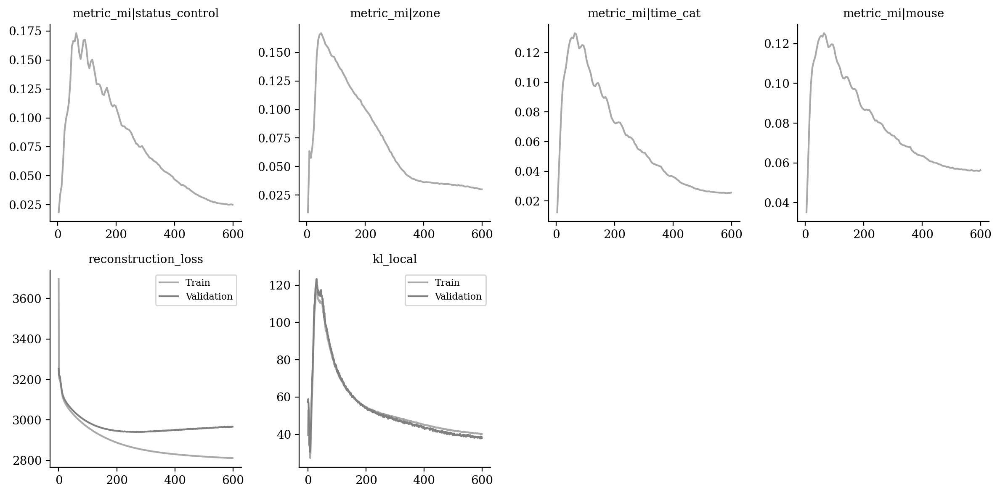

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

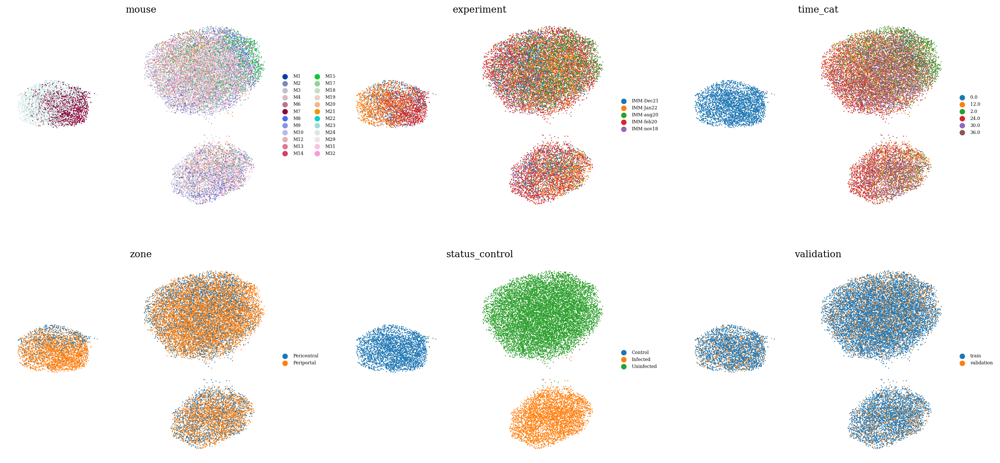

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

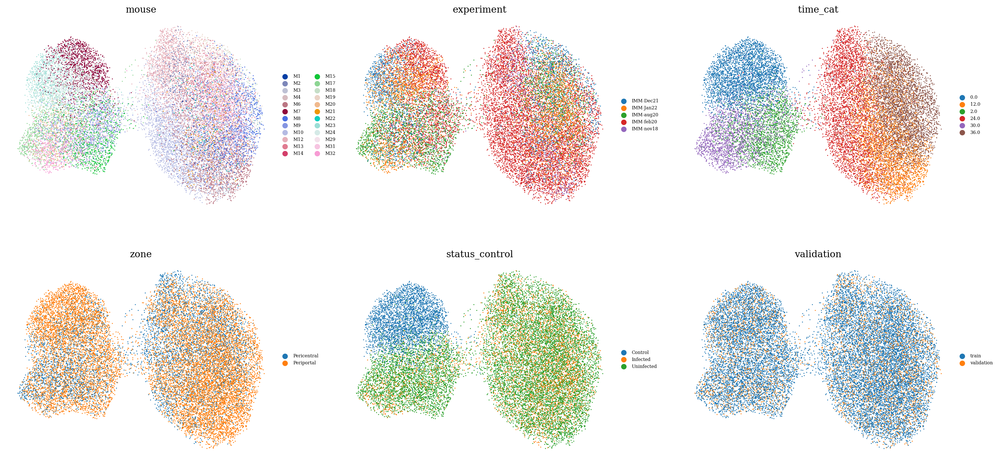

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

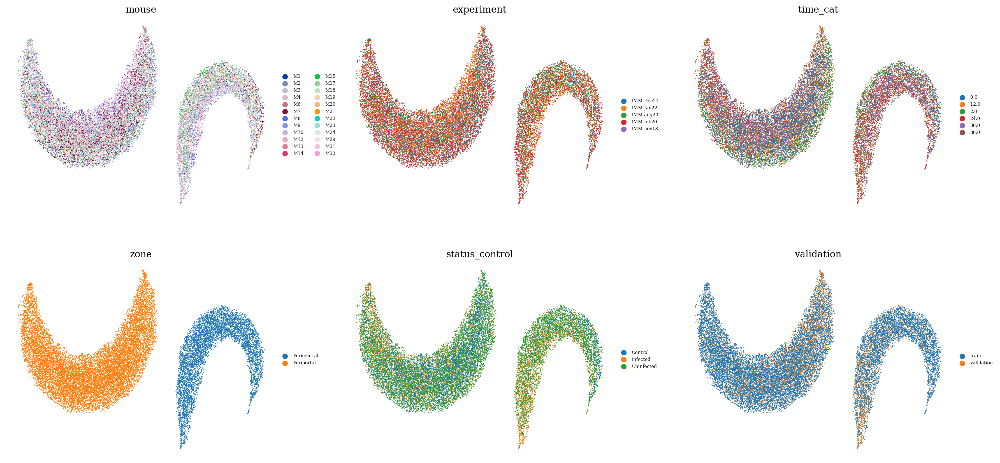

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

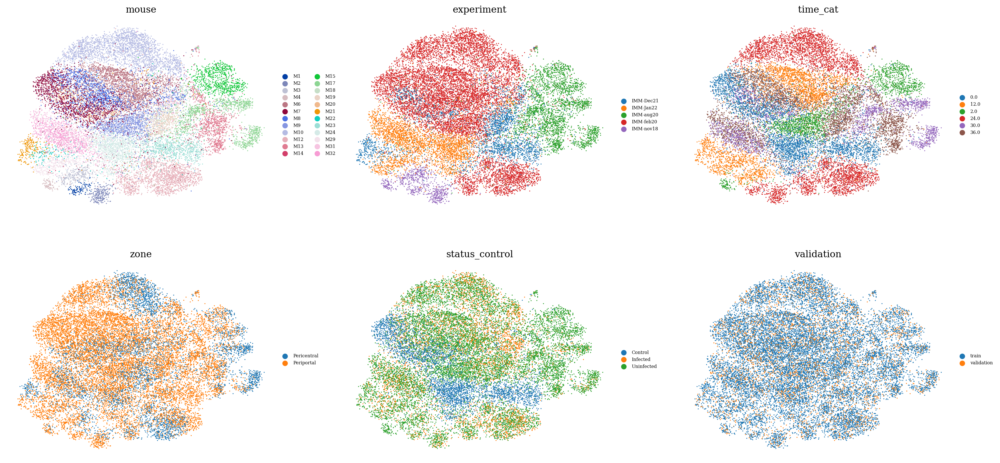

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

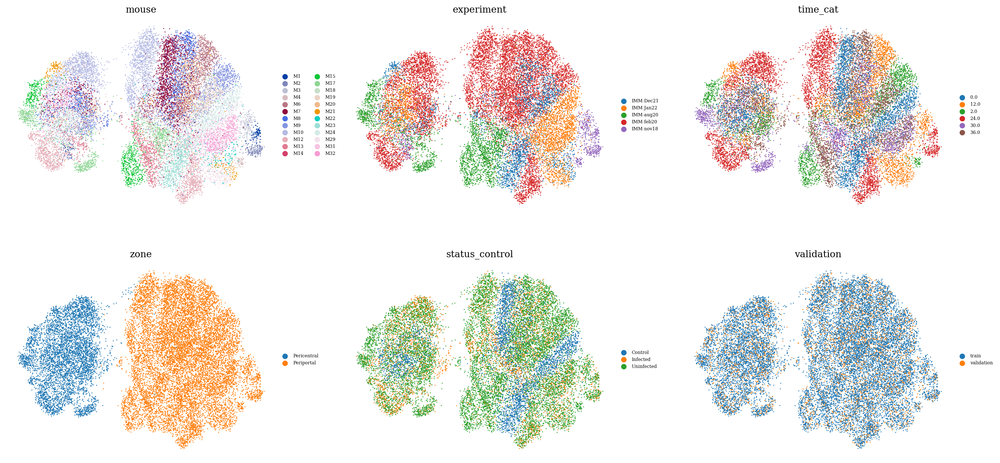

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

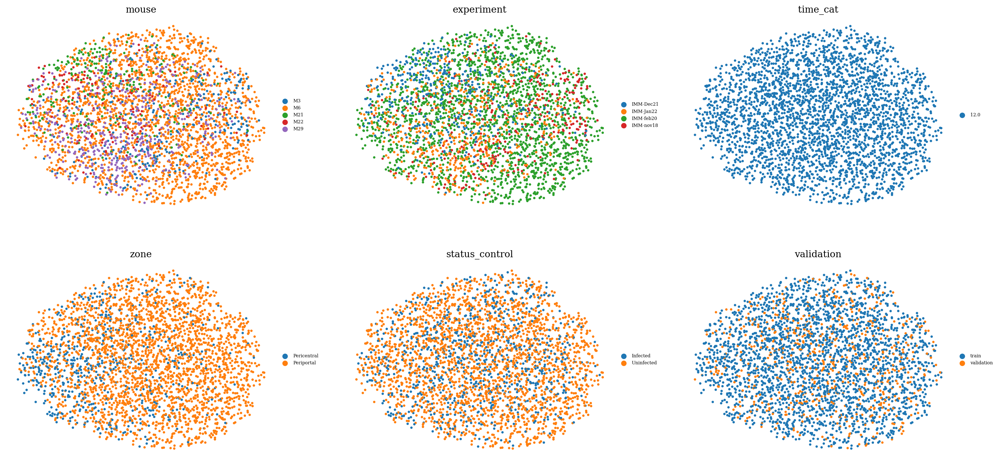

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )